This script contains the following:

1. Import Libraries and data
2. Create the X and y matrix and split it into training and testing sets
3. Grid search
4. Random Search
5. Run a random forest on the entire dataset
6. Filter DataFrame to include only data from the 2010's 
7. Filter DataFrame to include only data from the Basel Weather Station
8. Filter DataFrame to include only data from the Belgrade Weather Station
9. Filter DataFrame to include only data from the Budapest Weather Station

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import os
import operator
import time
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
import tensorflow as tf
from numpy import unique
from numpy import reshape
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, Conv2D, Dense, Dropout, BatchNormalization, Flatten, MaxPooling1D
from tensorflow.keras.layers import Dense, Activation, Dropout, Reshape, Permute
from tensorflow.keras.optimizers import Adam, SGD, RMSprop, Adadelta, Adagrad, Adamax, Nadam, Ftrl
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.layers import LeakyReLU
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn import datasets  
from sklearn.ensemble import RandomForestClassifier
from numpy import argmax
from sklearn import metrics  
from sklearn.tree import plot_tree
from sklearn import tree
from sklearn.model_selection import GridSearchCV
from scipy.stats import randint
from sklearn.model_selection import RandomizedSearchCV
from scikeras.wrappers import KerasClassifier 
from math import floor
from sklearn.metrics import make_scorer, accuracy_score
from bayes_opt import BayesianOptimization
from sklearn.model_selection import StratifiedKFold
LeakyReLU = LeakyReLU(alpha=0.1)
import warnings
warnings.filterwarnings('ignore')
pd.set_option("display.max_columns", None)

# Define LeakyReLU activation
LeakyReLU = tf.keras.layers.LeakyReLU(alpha=0.1)

D:\DataAlalytics\Anaconda3\Lib\site-packages\keras\src\layers\activations\leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


In [2]:
## Path
path = r'C:\Users\Family Computer\Documents\Data Analytics\ClimateWins'

In [3]:
# Import unscaled Dataset-weather-prediction-dataset-processed_cleaned.pkl
climate=pd.read_pickle(os.path.join(path,'02 Data', 'Prepared Data', 'Dataset-weather-prediction-dataset-processed_cleaned.pkl'))

In [4]:
climate.head()

,DATE,MONTH,BASEL_cloud_cover,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_sunshine,BASEL_temp_mean,BASEL_temp_min,BASEL_temp_max,BELGRADE_cloud_cover,BELGRADE_humidity,BELGRADE_pressure,BELGRADE_global_radiation,BELGRADE_precipitation,BELGRADE_sunshine,BELGRADE_temp_mean,BELGRADE_temp_min,BELGRADE_temp_max,BUDAPEST_cloud_cover,BUDAPEST_humidity,BUDAPEST_pressure,BUDAPEST_global_radiation,BUDAPEST_precipitation,BUDAPEST_sunshine,BUDAPEST_temp_mean,BUDAPEST_temp_min,BUDAPEST_temp_max,DEBILT_cloud_cover,DEBILT_humidity,DEBILT_pressure,DEBILT_global_radiation,DEBILT_precipitation,DEBILT_sunshine,DEBILT_temp_mean,DEBILT_temp_min,DEBILT_temp_max,DUSSELDORF_cloud_cover,DUSSELDORF_humidity,DUSSELDORF_pressure,DUSSELDORF_global_radiation,DUSSELDORF_precipitation,DUSSELDORF_sunshine,DUSSELDORF_temp_mean,DUSSELDORF_temp_min,DUSSELDORF_temp_max,HEATHROW_cloud_cover,HEATHROW_humidity,HEATHROW_pressure,HEATHROW_global_radiation,HEATHROW_precipitation,HEATHROW_sunshine,HEATHROW_temp_mean,HEATHROW_temp_min,HEATHROW_temp_max,KASSEL_cloud_cover,KASSEL_humidity,KASSEL_pressure,KASSEL_global_radiation,KASSEL_precipitation,KASSEL_sunshine,KASSEL_temp_mean,KASSEL_temp_min,KASSEL_temp_max,LJUBLJANA_cloud_cover,LJUBLJANA_humidity,LJUBLJANA_pressure,LJUBLJANA_global_radiation,LJUBLJANA_precipitation,LJUBLJANA_sunshine,LJUBLJANA_temp_mean,LJUBLJANA_temp_min,LJUBLJANA_temp_max,MAASTRICHT_cloud_cover,MAASTRICHT_humidity,MAASTRICHT_pressure,MAASTRICHT_global_radiation,MAASTRICHT_precipitation,MAASTRICHT_sunshine,MAASTRICHT_temp_mean,MAASTRICHT_temp_min,MAASTRICHT_temp_max,MADRID_cloud_cover,MADRID_humidity,MADRID_pressure,MADRID_global_radiation,MADRID_precipitation,MADRID_sunshine,MADRID_temp_mean,MADRID_temp_min,MADRID_temp_max,MUNCHENB_cloud_cover,MUNCHENB_humidity,MUNCHENB_pressure,MUNCHENB_global_radiation,MUNCHENB_precipitation,MUNCHENB_sunshine,MUNCHENB_temp_mean,MUNCHENB_temp_min,MUNCHENB_temp_max,OSLO_cloud_cover,OSLO_humidity,OSLO_pressure,OSLO_global_radiation,OSLO_precipitation,OSLO_sunshine,OSLO_temp_mean,OSLO_temp_min,OSLO_temp_max,SONNBLICK_cloud_cover,SONNBLICK_humidity,SONNBLICK_pressure,SONNBLICK_global_radiation,SONNBLICK_precipitation,SONNBLICK_sunshine,SONNBLICK_temp_mean,SONNBLICK_temp_min,SONNBLICK_temp_max,STOCKHOLM_cloud_cover,STOCKHOLM_humidity,STOCKHOLM_pressure,STOCKHOLM_global_radiation,STOCKHOLM_precipitation,STOCKHOLM_sunshine,STOCKHOLM_temp_mean,STOCKHOLM_temp_min,STOCKHOLM_temp_max,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
0,19600101,1,7,0.85,1.018,0.32,0.09,0.7,6.5,0.8,10.9,1,0.81,1.0195,0.88,0.00,7.0,3.7,-0.9,7.9,4,0.67,1.017,0.44,0.01,2.3,2.4,-0.4,5.1,7,0.85,1.0032,0.07,0.25,0.0,9.3,7.4,11.0,8,0.83,1.0161,0.12,0.08,0.0,10.0,7.0,11.5,7,0.91,1.0010,0.13,0.22,0.0,10.6,9.4,8.3,8,0.82,1.0094,0.28,0.48,1.6,7.9,3.9,9.4,8,1.00,1.0173,0.20,0.00,0.0,-0.6,-1.9,0.5,7,0.83,1.0063,0.22,0.32,1.0,9.5,8.5,11.1,6,0.92,1.0260,0.53,0.0,1.4,7.6,4.4,10.8,5,0.67,1.0304,0.20,0.10,0.0,6.9,1.1,10.4,8,0.98,0.9978,0.04,1.14,0.0,4.9,3.8,5.9,4,0.73,1.0304,0.48,0.01,2.3,-5.9,-8.5,-3.2,5,0.98,1.0114,0.05,0.32,0.0,4.2,2.2,4.9,5,0.88,1.0003,0.45,0.34,4.7,8.5,6.0,10.9
1,19600102,1,6,0.84,1.018,0.36,1.05,1.1,6.1,3.3,10.1,6,0.84,1.0172,0.25,0.00,0.0,2.9,2.2,4.4,4,0.67,1.017,0.18,0.31,0.0,2.3,1.4,3.1,8,0.90,1.0056,0.14,0.06,0.1,7.7,6.4,8.3,8,0.89,1.0161,0.18,0.66,0.5,8.2,7.4,11.0,7,0.98,1.0051,0.13,0.23,0.0,6.1,3.9,10.6,6,0.86,1.0086,0.12,0.27,0.0,7.7,6.8,9.1,6,0.94,1.0173,0.56,0.13,3.2,2.1,-1.3,5.5,8,0.92,1.0062,0.17,1.34,0.4,8.6,7.5,9.9,7,0.86,1.0254,0.46,0.0,0.9,9.8,7.4,12.2,6,0.72,1.0292,0.61,0.30,5.1,6.2,4.2,10.2,8,0.62,1.0139,0.04,0.00,0.0,3.4,2.8,4.9,6,0.97,1.0292,0.21,0.61,0.0,-9.5,-10.5,-8.5,5,0.62,1.0114,0.05,0.06,0.0,4.0,3.0,5.0,7,0.91,1.0007,0.25,0.84,0.7,8.9,5.6,12.1
2,19600103,1,8,0.90,1.018,0.18,0.30,0.0,8.5,5.1,9.9,6,0.77,1.0179,0.67,0.00,3.5,3.1,-0.5,6.4,4,0.67,1.017,0.30

In [5]:
climate.shape

(22950, 137)

In [6]:
# Drop the date and month column
climate2 = climate.drop(columns=['DATE', 'MONTH'])

In [7]:
climate2.head()

,BASEL_cloud_cover,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_sunshine,BASEL_temp_mean,BASEL_temp_min,BASEL_temp_max,BELGRADE_cloud_cover,BELGRADE_humidity,BELGRADE_pressure,BELGRADE_global_radiation,BELGRADE_precipitation,BELGRADE_sunshine,BELGRADE_temp_mean,BELGRADE_temp_min,BELGRADE_temp_max,BUDAPEST_cloud_cover,BUDAPEST_humidity,BUDAPEST_pressure,BUDAPEST_global_radiation,BUDAPEST_precipitation,BUDAPEST_sunshine,BUDAPEST_temp_mean,BUDAPEST_temp_min,BUDAPEST_temp_max,DEBILT_cloud_cover,DEBILT_humidity,DEBILT_pressure,DEBILT_global_radiation,DEBILT_precipitation,DEBILT_sunshine,DEBILT_temp_mean,DEBILT_temp_min,DEBILT_temp_max,DUSSELDORF_cloud_cover,DUSSELDORF_humidity,DUSSELDORF_pressure,DUSSELDORF_global_radiation,DUSSELDORF_precipitation,DUSSELDORF_sunshine,DUSSELDORF_temp_mean,DUSSELDORF_temp_min,DUSSELDORF_temp_max,HEATHROW_cloud_cover,HEATHROW_humidity,HEATHROW_pressure,HEATHROW_global_radiation,HEATHROW_precipitation,HEATHROW_sunshine,HEATHROW_temp_mean,HEATHROW_temp_min,HEATHROW_temp_max,KASSEL_cloud_cover,KASSEL_humidity,KASSEL_pressure,KASSEL_global_radiation,KASSEL_precipitation,KASSEL_sunshine,KASSEL_temp_mean,KASSEL_temp_min,KASSEL_temp_max,LJUBLJANA_cloud_cover,LJUBLJANA_humidity,LJUBLJANA_pressure,LJUBLJANA_global_radiation,LJUBLJANA_precipitation,LJUBLJANA_sunshine,LJUBLJANA_temp_mean,LJUBLJANA_temp_min,LJUBLJANA_temp_max,MAASTRICHT_cloud_cover,MAASTRICHT_humidity,MAASTRICHT_pressure,MAASTRICHT_global_radiation,MAASTRICHT_precipitation,MAASTRICHT_sunshine,MAASTRICHT_temp_mean,MAASTRICHT_temp_min,MAASTRICHT_temp_max,MADRID_cloud_cover,MADRID_humidity,MADRID_pressure,MADRID_global_radiation,MADRID_precipitation,MADRID_sunshine,MADRID_temp_mean,MADRID_temp_min,MADRID_temp_max,MUNCHENB_cloud_cover,MUNCHENB_humidity,MUNCHENB_pressure,MUNCHENB_global_radiation,MUNCHENB_precipitation,MUNCHENB_sunshine,MUNCHENB_temp_mean,MUNCHENB_temp_min,MUNCHENB_temp_max,OSLO_cloud_cover,OSLO_humidity,OSLO_pressure,OSLO_global_radiation,OSLO_precipitation,OSLO_sunshine,OSLO_temp_mean,OSLO_temp_min,OSLO_temp_max,SONNBLICK_cloud_cover,SONNBLICK_humidity,SONNBLICK_pressure,SONNBLICK_global_radiation,SONNBLICK_precipitation,SONNBLICK_sunshine,SONNBLICK_temp_mean,SONNBLICK_temp_min,SONNBLICK_temp_max,STOCKHOLM_cloud_cover,STOCKHOLM_humidity,STOCKHOLM_pressure,STOCKHOLM_global_radiation,STOCKHOLM_precipitation,STOCKHOLM_sunshine,STOCKHOLM_temp_mean,STOCKHOLM_temp_min,STOCKHOLM_temp_max,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
0,7,0.85,1.018,0.32,0.09,0.7,6.5,0.8,10.9,1,0.81,1.0195,0.88,0.00,7.0,3.7,-0.9,7.9,4,0.67,1.017,0.44,0.01,2.3,2.4,-0.4,5.1,7,0.85,1.0032,0.07,0.25,0.0,9.3,7.4,11.0,8,0.83,1.0161,0.12,0.08,0.0,10.0,7.0,11.5,7,0.91,1.0010,0.13,0.22,0.0,10.6,9.4,8.3,8,0.82,1.0094,0.28,0.48,1.6,7.9,3.9,9.4,8,1.00,1.0173,0.20,0.00,0.0,-0.6,-1.9,0.5,7,0.83,1.0063,0.22,0.32,1.0,9.5,8.5,11.1,6,0.92,1.0260,0.53,0.0,1.4,7.6,4.4,10.8,5,0.67,1.0304,0.20,0.10,0.0,6.9,1.1,10.4,8,0.98,0.9978,0.04,1.14,0.0,4.9,3.8,5.9,4,0.73,1.0304,0.48,0.01,2.3,-5.9,-8.5,-3.2,5,0.98,1.0114,0.05,0.32,0.0,4.2,2.2,4.9,5,0.88,1.0003,0.45,0.34,4.7,8.5,6.0,10.9
1,6,0.84,1.018,0.36,1.05,1.1,6.1,3.3,10.1,6,0.84,1.0172,0.25,0.00,0.0,2.9,2.2,4.4,4,0.67,1.017,0.18,0.31,0.0,2.3,1.4,3.1,8,0.90,1.0056,0.14,0.06,0.1,7.7,6.4,8.3,8,0.89,1.0161,0.18,0.66,0.5,8.2,7.4,11.0,7,0.98,1.0051,0.13,0.23,0.0,6.1,3.9,10.6,6,0.86,1.0086,0.12,0.27,0.0,7.7,6.8,9.1,6,0.94,1.0173,0.56,0.13,3.2,2.1,-1.3,5.5,8,0.92,1.0062,0.17,1.34,0.4,8.6,7.5,9.9,7,0.86,1.0254,0.46,0.0,0.9,9.8,7.4,12.2,6,0.72,1.0292,0.61,0.30,5.1,6.2,4.2,10.2,8,0.62,1.0139,0.04,0.00,0.0,3.4,2.8,4.9,6,0.97,1.0292,0.21,0.61,0.0,-9.5,-10.5,-8.5,5,0.62,1.0114,0.05,0.06,0.0,4.0,3.0,5.0,7,0.91,1.0007,0.25,0.84,0.7,8.9,5.6,12.1
2,8,0.90,1.018,0.18,0.30,0.0,8.5,5.1,9.9,6,0.77,1.0179,0.67,0.00,3.5,3.1,-0.5,6.4,4,0.67,1.017,0.30,0.00,0.6,2.7,1.7,5.3,6,0.92,1.0165,0.28,0.0

In [8]:
column_names = [
    'BASEL_cloud_cover', 'BASEL_humidity', 'BASEL_pressure', 'BASEL_global_radiation', 'BASEL_precipitation', 
    'BASEL_sunshine', 'BASEL_temp_mean', 'BASEL_temp_min', 'BASEL_temp_max', 'BELGRADE_cloud_cover', 
    'BELGRADE_humidity', 'BELGRADE_pressure', 'BELGRADE_global_radiation', 'BELGRADE_precipitation', 
    'BELGRADE_sunshine', 'BELGRADE_temp_mean', 'BELGRADE_temp_min', 'BELGRADE_temp_max', 'BUDAPEST_cloud_cover', 
    'BUDAPEST_humidity', 'BUDAPEST_pressure', 'BUDAPEST_global_radiation', 'BUDAPEST_precipitation', 
    'BUDAPEST_sunshine', 'BUDAPEST_temp_mean', 'BUDAPEST_temp_min', 'BUDAPEST_temp_max', 'DEBILT_cloud_cover', 
    'DEBILT_humidity', 'DEBILT_pressure', 'DEBILT_global_radiation', 'DEBILT_precipitation', 'DEBILT_sunshine', 
    'DEBILT_temp_mean', 'DEBILT_temp_min', 'DEBILT_temp_max', 'DUSSELDORF_cloud_cover', 'DUSSELDORF_humidity', 
    'DUSSELDORF_pressure', 'DUSSELDORF_global_radiation', 'DUSSELDORF_precipitation', 'DUSSELDORF_sunshine', 
    'DUSSELDORF_temp_mean', 'DUSSELDORF_temp_min', 'DUSSELDORF_temp_max', 'HEATHROW_cloud_cover', 
    'HEATHROW_humidity', 'HEATHROW_pressure', 'HEATHROW_global_radiation', 'HEATHROW_precipitation', 
    'HEATHROW_sunshine', 'HEATHROW_temp_mean', 'HEATHROW_temp_min', 'HEATHROW_temp_max', 'KASSEL_cloud_cover', 
    'KASSEL_humidity', 'KASSEL_pressure', 'KASSEL_global_radiation', 'KASSEL_precipitation', 'KASSEL_sunshine', 
    'KASSEL_temp_mean', 'KASSEL_temp_min', 'KASSEL_temp_max', 'LJUBLJANA_cloud_cover', 'LJUBLJANA_humidity', 
    'LJUBLJANA_pressure', 'LJUBLJANA_global_radiation', 'LJUBLJANA_precipitation', 'LJUBLJANA_sunshine', 
    'LJUBLJANA_temp_mean', 'LJUBLJANA_temp_min', 'LJUBLJANA_temp_max', 'MAASTRICHT_cloud_cover', 
    'MAASTRICHT_humidity', 'MAASTRICHT_pressure', 'MAASTRICHT_global_radiation', 'MAASTRICHT_precipitation', 
    'MAASTRICHT_sunshine', 'MAASTRICHT_temp_mean', 'MAASTRICHT_temp_min', 'MAASTRICHT_temp_max', 'MADRID_cloud_cover', 
    'MADRID_humidity', 'MADRID_pressure', 'MADRID_global_radiation', 'MADRID_precipitation', 'MADRID_sunshine', 
    'MADRID_temp_mean', 'MADRID_temp_min', 'MADRID_temp_max', 'MUNCHENB_cloud_cover', 'MUNCHENB_humidity', 
    'MUNCHENB_pressure', 'MUNCHENB_global_radiation', 'MUNCHENB_precipitation', 'MUNCHENB_sunshine', 
    'MUNCHENB_temp_mean', 'MUNCHENB_temp_min', 'MUNCHENB_temp_max', 'OSLO_cloud_cover', 'OSLO_humidity', 
    'OSLO_pressure', 'OSLO_global_radiation', 'OSLO_precipitation', 'OSLO_sunshine', 'OSLO_temp_mean', 
    'OSLO_temp_min', 'OSLO_temp_max', 'SONNBLICK_cloud_cover', 'SONNBLICK_humidity', 'SONNBLICK_pressure', 
    'SONNBLICK_global_radiation', 'SONNBLICK_precipitation', 'SONNBLICK_sunshine', 'SONNBLICK_temp_mean', 
    'SONNBLICK_temp_min', 'SONNBLICK_temp_max', 'STOCKHOLM_cloud_cover', 'STOCKHOLM_humidity', 'STOCKHOLM_pressure', 
    'STOCKHOLM_global_radiation', 'STOCKHOLM_precipitation', 'STOCKHOLM_sunshine', 'STOCKHOLM_temp_mean', 
    'STOCKHOLM_temp_min', 'STOCKHOLM_temp_max', 'VALENTIA_cloud_cover', 'VALENTIA_humidity', 'VALENTIA_pressure', 
    'VALENTIA_global_radiation', 'VALENTIA_precipitation', 'VALENTIA_sunshine', 'VALENTIA_temp_mean', 
    'VALENTIA_temp_min', 'VALENTIA_temp_max'
]

# Using a set to retain only unique values after splitting by '_'
unique_column_names = set([name.split('_', 1)[1] for name in column_names])

print(list(unique_column_names))

['cloud_cover', 'temp_max', 'sunshine', 'temp_mean', 'humidity', 'temp_min', 'global_radiation', 'pressure', 'precipitation']


In [9]:
unique_column_names

{'cloud_cover',
 'global_radiation',
 'humidity',
 'precipitation',
 'pressure',
 'sunshine',
 'temp_max',
 'temp_mean',
 'temp_min'}

In [10]:
# Import Dataset-Answers-Weather_Prediction_Pleasant_Weather.csv
answers=pd.read_csv(os.path.join(path,'02 Data', 'Original Data', 'Dataset-Answers-Weather_Prediction_Pleasant_Weather.csv'), index_col = False)

In [11]:
answers.head()

,DATE,BASEL_pleasant_weather,BELGRADE_pleasant_weather,BUDAPEST_pleasant_weather,DEBILT_pleasant_weather,DUSSELDORF_pleasant_weather,HEATHROW_pleasant_weather,KASSEL_pleasant_weather,LJUBLJANA_pleasant_weather,MAASTRICHT_pleasant_weather,MADRID_pleasant_weather,MUNCHENB_pleasant_weather,OSLO_pleasant_weather,SONNBLICK_pleasant_weather,STOCKHOLM_pleasant_weather,VALENTIA_pleasant_weather
0,19600101,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,19600102,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,19600103,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,19600104,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,19600105,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [12]:
answers.shape

(22950, 16)

In [13]:
# Drop the date column
answers2 = answers.drop(columns=['DATE'])

In [14]:
answers2.head()

,BASEL_pleasant_weather,BELGRADE_pleasant_weather,BUDAPEST_pleasant_weather,DEBILT_pleasant_weather,DUSSELDORF_pleasant_weather,HEATHROW_pleasant_weather,KASSEL_pleasant_weather,LJUBLJANA_pleasant_weather,MAASTRICHT_pleasant_weather,MADRID_pleasant_weather,MUNCHENB_pleasant_weather,OSLO_pleasant_weather,SONNBLICK_pleasant_weather,STOCKHOLM_pleasant_weather,VALENTIA_pleasant_weather
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [15]:
answers2.shape

(22950, 15)

In [16]:
print(answers2.columns.tolist())

['BASEL_pleasant_weather', 'BELGRADE_pleasant_weather', 'BUDAPEST_pleasant_weather', 'DEBILT_pleasant_weather', 'DUSSELDORF_pleasant_weather', 'HEATHROW_pleasant_weather', 'KASSEL_pleasant_weather', 'LJUBLJANA_pleasant_weather', 'MAASTRICHT_pleasant_weather', 'MADRID_pleasant_weather', 'MUNCHENB_pleasant_weather', 'OSLO_pleasant_weather', 'SONNBLICK_pleasant_weather', 'STOCKHOLM_pleasant_weather', 'VALENTIA_pleasant_weather']


In [17]:
answers2.columns[0].split('_')[0]

'BASEL'

In [18]:
stations = [col.split('_')[0] for col in answers2.columns]

In [19]:
stations

['BASEL',
 'BELGRADE',
 'BUDAPEST',
 'DEBILT',
 'DUSSELDORF',
 'HEATHROW',
 'KASSEL',
 'LJUBLJANA',
 'MAASTRICHT',
 'MADRID',
 'MUNCHENB',
 'OSLO',
 'SONNBLICK',
 'STOCKHOLM',
 'VALENTIA']

## Create the X and y matrix and split it into training and testing sets

In [20]:
#Create an 'X' matrix
X = climate2
y = answers2

In [21]:
print(X.shape)
print(y.shape)

(22950, 135)
(22950, 15)


In [22]:
#Split data into training and testing sets.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [23]:
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(18360, 135) (18360, 15)
(4590, 135) (4590, 15)


In [24]:
y_train = y_train.astype(int)

In [25]:
y_train

,BASEL_pleasant_weather,BELGRADE_pleasant_weather,BUDAPEST_pleasant_weather,DEBILT_pleasant_weather,DUSSELDORF_pleasant_weather,HEATHROW_pleasant_weather,KASSEL_pleasant_weather,LJUBLJANA_pleasant_weather,MAASTRICHT_pleasant_weather,MADRID_pleasant_weather,MUNCHENB_pleasant_weather,OSLO_pleasant_weather,SONNBLICK_pleasant_weather,STOCKHOLM_pleasant_weather,VALENTIA_pleasant_weather
12262,0,1,1,1,0,1,0,1,0,1,0,0,0,0,0
9334,1,1,1,0,0,0,0,1,0,0,1,0,0,0,0
7100,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0
12030,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2958,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11964,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0
21575,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5390,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0
860,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0


In [26]:
print(y_train.shape)
print(y_train)

(18360, 15)
       BASEL_pleasant_weather  BELGRADE_pleasant_weather  \
12262                       0                          1   
9334                        1                          1   
7100                        0                          0   
12030                       0                          0   
2958                        0                          0   
...                       ...                        ...   
11964                       0                          1   
21575                       0                          0   
5390                        0                          1   
860                         0                          0   
15795                       0                          1   

       BUDAPEST_pleasant_weather  DEBILT_pleasant_weather  \
12262                          1                        1   
9334                           1                        0   
7100                           1                        0   
12030                  

In [27]:
len(X_train)

18360

## GRID SEARCH

In [28]:
# creating a RF classifier
clf = RandomForestClassifier()

In [29]:
# Grid search cv
grid_space={'max_depth':[3,5,10,None],
              'n_estimators':[10,100,200],
              'max_features':[1,3,5,7],
              'min_samples_leaf':[1,2,3],
              'min_samples_split':[1,2,3]
           }

In [30]:
start = time.time()
grid = GridSearchCV(clf,param_grid=grid_space,cv=3,scoring='accuracy', verbose=3, n_jobs=-1)
model_grid = grid.fit(X_train, y_train)
print('Search took %s minutes' % ((time.time() - start)/60))

Fitting 3 folds for each of 432 candidates, totalling 1296 fits
Search took 5.189049235979716 minutes


In [31]:
# grid search results
print('Best GRID search hyperparameters are: '+str(model_grid.best_params_))
print('Best GRID search score is: '+str(model_grid.best_score_))

Best GRID search hyperparameters are: {'max_depth': None, 'max_features': 7, 'min_samples_leaf': 1, 'min_samples_split': 3, 'n_estimators': 200}
Best GRID search score is: 0.6288671023965141


## RANDOM SEARCH 1

In [32]:
# Random search cv
rs_space={'max_depth':list(np.arange(10, 100, step=10)) + [None],
              'n_estimators':np.arange(10, 500, step=50),
              'max_features':randint(1,7),
              'criterion':['gini','entropy'],
              'min_samples_leaf':randint(1,4),
              'min_samples_split':np.arange(2, 10, step=2)
         }

In [33]:
# creating a RF classifier
clf2= RandomForestClassifier()

In [34]:
start = time.time()
rf_random = RandomizedSearchCV(clf2, rs_space, n_iter=200, scoring='accuracy', verbose=3, n_jobs=-1, cv=3) #500
model_random = rf_random.fit(X_train, y_train)
print('Search took %s minutes' % ((time.time() - start)/60))

Fitting 3 folds for each of 200 candidates, totalling 600 fits
Search took 13.118601290384929 minutes


In [35]:
# random search results
print('Best RANDOM search hyperparameters are: '+str(model_random.best_params_))
print('Best RANDOM search score is: '+str(model_random.best_score_))

Best RANDOM search hyperparameters are: {'criterion': 'gini', 'max_depth': None, 'max_features': 6, 'min_samples_leaf': 1, 'min_samples_split': 6, 'n_estimators': 410}
Best RANDOM search score is: 0.6079520697167756


In [36]:
# grid search results
print('Best GRID search hyperparameters are: '+str(model_grid.best_params_))
print('Best GRID search score is: '+str(model_grid.best_score_))
# random search results
print('Best RANDOM search hyperparameters are: '+str(model_random.best_params_))
print('Best RANDOM search score is: '+str(model_random.best_score_))

Best GRID search hyperparameters are: {'max_depth': None, 'max_features': 7, 'min_samples_leaf': 1, 'min_samples_split': 3, 'n_estimators': 200}
Best GRID search score is: 0.6288671023965141
Best RANDOM search hyperparameters are: {'criterion': 'gini', 'max_depth': None, 'max_features': 6, 'min_samples_leaf': 1, 'min_samples_split': 6, 'n_estimators': 410}
Best RANDOM search score is: 0.6079520697167756


## Random Search 2

In [37]:
# Random search cv
rs_space={'max_depth':list(np.arange(10, 200, step=10)) + [None],
              'n_estimators':np.arange(10, 800, step=50),
              'max_features':randint(1,14),
              'criterion':['gini','entropy'],
              'min_samples_leaf':randint(1,4),
              'min_samples_split':np.arange(2, 10, step=2)
         }

In [38]:
# creating a RF classifier
clf_2= RandomForestClassifier()

In [39]:
start = time.time()
rf_random = RandomizedSearchCV(clf_2, rs_space, n_iter=500, scoring='accuracy', verbose=3, n_jobs=-1, cv=5)
model_random = rf_random.fit(X_train, y_train)
print('Search took %s minutes' % ((time.time() - start)/60))

Fitting 5 folds for each of 500 candidates, totalling 2500 fits
Search took 171.40277588367462 minutes


In [40]:
# random search results
print('Best RANDOM search hyperparameters are: '+str(model_random.best_params_))
print('Best RANDOM search score is: '+str(model_random.best_score_))

Best RANDOM search hyperparameters are: {'criterion': 'entropy', 'max_depth': 60, 'max_features': 13, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 710}
Best RANDOM search score is: 0.7281045751633985


In [41]:
# grid search results
print('Best GRID search hyperparameters are: '+str(model_grid.best_params_))
print('Best GRID search score is: '+str(model_grid.best_score_))
# random search results
print('Best RANDOM search hyperparameters are: '+str(model_random.best_params_))
print('Best RANDOM search score is: '+str(model_random.best_score_))

Best GRID search hyperparameters are: {'max_depth': None, 'max_features': 7, 'min_samples_leaf': 1, 'min_samples_split': 3, 'n_estimators': 200}
Best GRID search score is: 0.6288671023965141
Best RANDOM search hyperparameters are: {'criterion': 'entropy', 'max_depth': 60, 'max_features': 13, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 710}
Best RANDOM search score is: 0.7281045751633985


## Run a random forest on the entire dataset

In [42]:
# creating a RF classifier with the best results from above
clf3 = RandomForestClassifier(n_estimators = 710, max_depth=60, max_features=13, min_samples_leaf=1, min_samples_split=2, criterion = 'entropy')  
  
# Training the model on the training dataset
# fit function is used to train the model using the training sets as parameters
clf3.fit(X_train, y_train)

RandomForestClassifier(criterion='entropy', max_depth=60, max_features=13,
                       n_estimators=710)

In [43]:
# performing predictions on the test dataset
y_pred = clf3.predict(X_test)
  
# using metrics module for accuracy calculation
print("Model Accuracy: ", metrics.accuracy_score(y_test, y_pred))

Model Accuracy:  0.7507625272331154


[Text(0.3543531072792134, 0.9791666666666666, 'x[44] <= 16.95\nentropy = 0.697\nsamples = 11572\nvalue = [[13787.0, 4573.0]\n[11872.0, 6488.0]\n[12404.0, 5956.0]\n[14751.0, 3609.0]\n[14415.0, 3945.0]\n[14393.0, 3967.0]\n[15284.0, 3076.0]\n[13194.0, 5166.0]\n[14575.0, 3785.0]\n[10102.0, 8258.0]\n[14509.0, 3851.0]\n[15464.0, 2896.0]\n[18360.0, 0.0]\n[15171.0, 3189.0]\n[17355.0, 1005.0]]'),
 Text(0.07953788201739616, 0.9375, 'x[71] <= 13.55\nentropy = 0.213\nsamples = 6733\nvalue = [[10219, 446]\n[9218, 1447]\n[9711, 954]\n[10635, 30]\n[10665, 0]\n[10254, 411]\n[10628, 37]\n[9938, 727]\n[10653, 12]\n[8264, 2401]\n[10397, 268]\n[10500, 165]\n[10665, 0]\n[10514, 151]\n[10526, 139]]'),
 Text(0.017863448218665808, 0.8958333333333334, 'x[26] <= 11.75\nentropy = 0.058\nsamples = 4747\nvalue = [[7428, 18]\n[7195, 251]\n[7398, 48]\n[7442, 4]\n[7446, 0]\n[7412, 34]\n[7446, 0]\n[7446, 0]\n[7445, 1]\n[6742, 704]\n[7439, 7]\n[7421, 25]\n[7446, 0]\n[7441, 5]\n[7427, 19]]'),
 Text(0.004242229281434718,

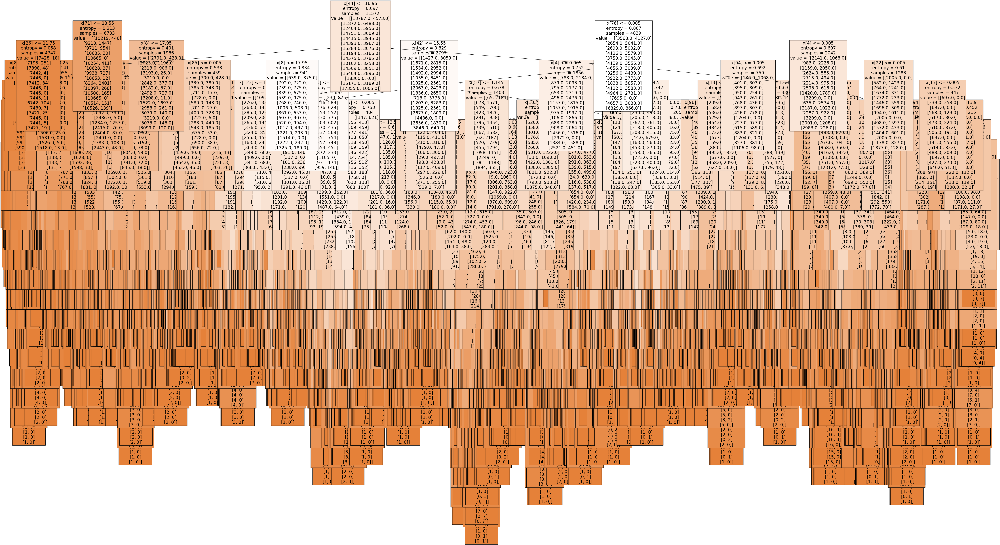

In [44]:
# Define the class names corresponding to the integer labels
class_names = ['unpleasant', 'pleasant']

# Create the figure and plot the decision tree
fig = plt.figure(figsize=(80, 40))
plot_tree(clf3.estimators_[5], fontsize=20, class_names=class_names, filled=True)

In [45]:
fig.savefig(f"{path}/04 Analysis/Visualizations/decision_tree11.png")

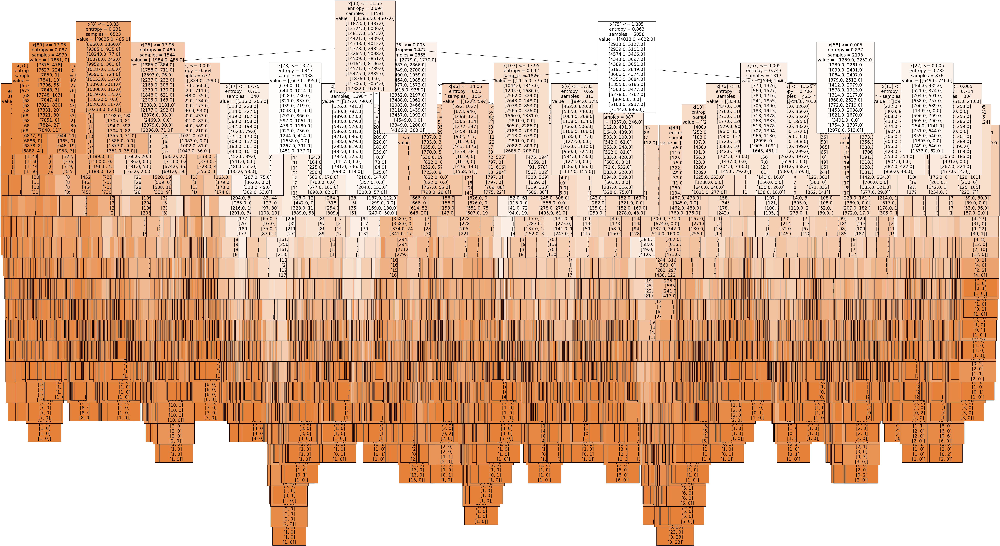

In [46]:
fig12 = plt.figure(figsize=(80,40))
plot_tree(clf3.estimators_[99], fontsize = 20, class_names=class_names, filled=True);

In [47]:
fig12.savefig(f"{path}/04 Analysis/Visualizations/decision_tree12.png")

In [48]:
np.set_printoptions(threshold=np.inf)
newarray = clf3.feature_importances_
#print(clf3.feature_importances_.shape)
newarray

array([0.00209172, 0.00246978, 0.00176862, 0.00327897, 0.01952419,
       0.00488287, 0.02332268, 0.00414896, 0.0318361 , 0.00288225,
       0.00281296, 0.0027043 , 0.0029713 , 0.02098932, 0.00347299,
       0.01026989, 0.00307079, 0.01261848, 0.00131829, 0.00162934,
       0.00154112, 0.00262081, 0.01848862, 0.00285421, 0.01221906,
       0.0042012 , 0.01935593, 0.00228287, 0.00216316, 0.00356185,
       0.00381778, 0.01810067, 0.00340691, 0.01237774, 0.00206002,
       0.03618208, 0.00320254, 0.00220899, 0.00241762, 0.0034509 ,
       0.02046563, 0.00559855, 0.02392921, 0.00237479, 0.04216266,
       0.00170008, 0.00279594, 0.00335824, 0.00342748, 0.01171127,
       0.00317162, 0.00968341, 0.00238886, 0.01720273, 0.00222775,
       0.00242992, 0.00255302, 0.00298679, 0.01496498, 0.00323922,
       0.00638016, 0.00249807, 0.01220029, 0.00225072, 0.00268783,
       0.00243238, 0.00338856, 0.0221749 , 0.00359295, 0.017359  ,
       0.0026907 , 0.03022753, 0.0038809 , 0.00239767, 0.00312

In [49]:
np.set_printoptions(threshold=1000)

In [50]:
newarray = newarray.reshape(-1,15,9)
print(newarray.shape)
newarray

(1, 15, 9)


array([[[0.00209172, 0.00246978, 0.00176862, 0.00327897, 0.01952419,
         0.00488287, 0.02332268, 0.00414896, 0.0318361 ],
        [0.00288225, 0.00281296, 0.0027043 , 0.0029713 , 0.02098932,
         0.00347299, 0.01026989, 0.00307079, 0.01261848],
        [0.00131829, 0.00162934, 0.00154112, 0.00262081, 0.01848862,
         0.00285421, 0.01221906, 0.0042012 , 0.01935593],
        [0.00228287, 0.00216316, 0.00356185, 0.00381778, 0.01810067,
         0.00340691, 0.01237774, 0.00206002, 0.03618208],
        [0.00320254, 0.00220899, 0.00241762, 0.0034509 , 0.02046563,
         0.00559855, 0.02392921, 0.00237479, 0.04216266],
        [0.00170008, 0.00279594, 0.00335824, 0.00342748, 0.01171127,
         0.00317162, 0.00968341, 0.00238886, 0.01720273],
        [0.00222775, 0.00242992, 0.00255302, 0.00298679, 0.01496498,
         0.00323922, 0.00638016, 0.00249807, 0.01220029],
        [0.00225072, 0.00268783, 0.00243238, 0.00338856, 0.0221749 ,
         0.00359295, 0.017359  , 0.0026907

In [51]:
sumarray = np.sum(newarray[0], axis=1)
sumarray

array([0.09332389, 0.06179228, 0.06422858, 0.08395306, 0.10581089,
       0.05543963, 0.04948021, 0.08680456, 0.10478128, 0.06660309,
       0.0705637 , 0.05695036, 0.02283699, 0.05398526, 0.02344622])

In [52]:
important = pd.Series(sumarray, index = stations).sort_values(ascending = False)
important

DUSSELDORF    0.105811
MAASTRICHT    0.104781
BASEL         0.093324
LJUBLJANA     0.086805
DEBILT        0.083953
MUNCHENB      0.070564
MADRID        0.066603
BUDAPEST      0.064229
BELGRADE      0.061792
OSLO          0.056950
HEATHROW      0.055440
STOCKHOLM     0.053985
KASSEL        0.049480
VALENTIA      0.023446
SONNBLICK     0.022837
dtype: float64

Index(['BASEL_cloud_cover', 'BASEL_humidity', 'BASEL_pressure',
       'BASEL_global_radiation', 'BASEL_precipitation', 'BASEL_sunshine',
       'BASEL_temp_mean', 'BASEL_temp_min', 'BASEL_temp_max',
       'BELGRADE_cloud_cover',
       ...
       'STOCKHOLM_temp_max', 'VALENTIA_cloud_cover', 'VALENTIA_humidity',
       'VALENTIA_pressure', 'VALENTIA_global_radiation',
       'VALENTIA_precipitation', 'VALENTIA_sunshine', 'VALENTIA_temp_mean',
       'VALENTIA_temp_min', 'VALENTIA_temp_max'],
      dtype='object', length=135)


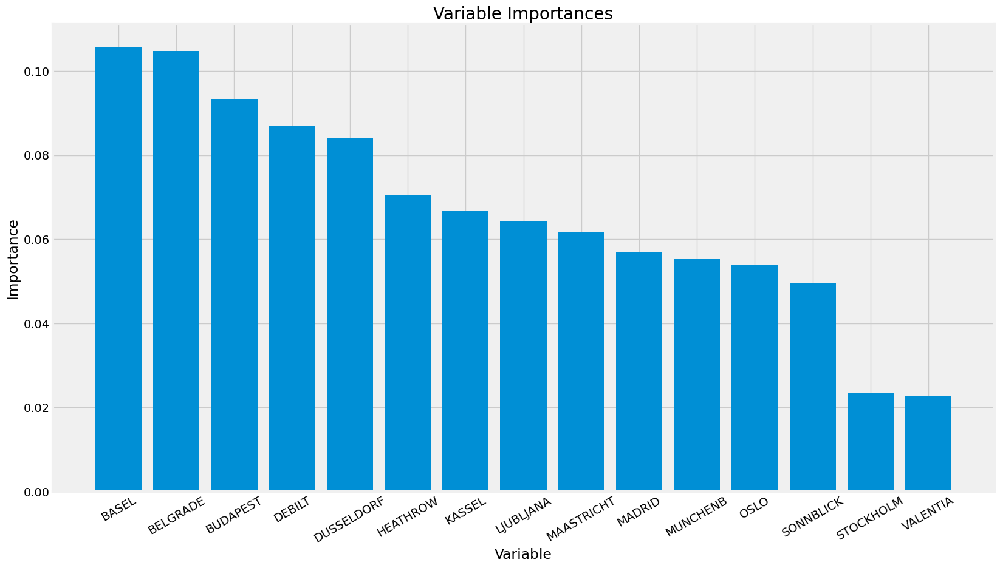

In [53]:
%matplotlib inline
plt.figure(figsize=(20,10))
plt.style.use('fivethirtyeight')
# list of x locations for plotting
x_values = list(range(len(important)))
print(X.columns)

plt.bar(x_values, important, orientation = 'vertical')
plt.xticks(x_values, stations, rotation=30)
plt.ylabel('Importance'); plt.xlabel('Variable'); plt.title('Variable Importances');

In [54]:
# By weather observations
sumarray2 = np.sum(newarray[0], axis=0)
sumarray2

array([0.03311051, 0.03654811, 0.03900869, 0.04876172, 0.22197515,
       0.05558906, 0.19188782, 0.04642726, 0.32669167])

In [55]:
important2 = pd.Series(sumarray2, index = unique_column_names).sort_values(ascending = False)
important2

precipitation       0.326692
humidity            0.221975
global_radiation    0.191888
temp_min            0.055589
temp_mean           0.048762
pressure            0.046427
sunshine            0.039009
temp_max            0.036548
cloud_cover         0.033111
dtype: float64

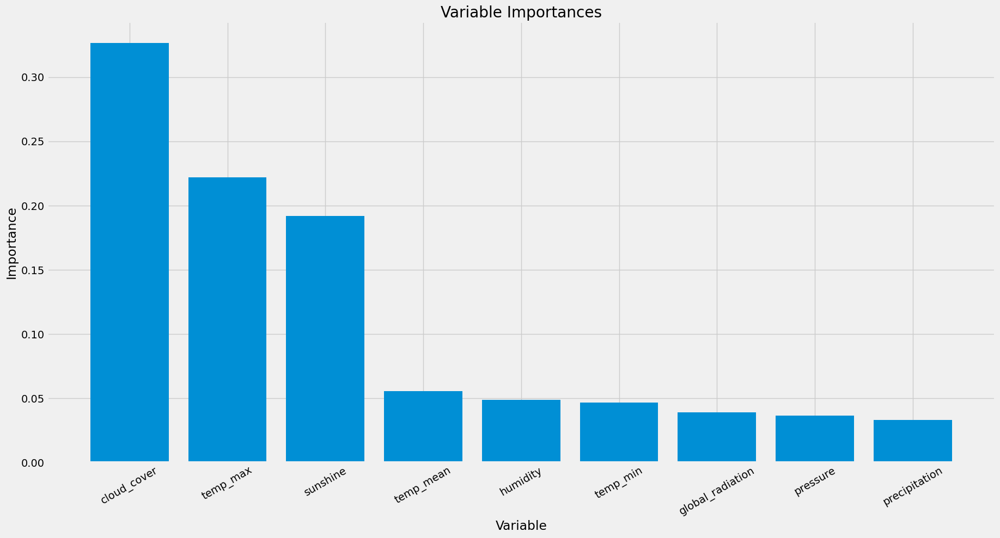

In [56]:
%matplotlib inline
plt.figure(figsize=(20, 10))
plt.style.use('fivethirtyeight')

# Plotting the importances
plt.bar(list(unique_column_names), list(important2), orientation='vertical')

# Rotating x-axis labels for better readability
plt.xticks(rotation=30)

# Adding labels and title
plt.ylabel('Importance')
plt.xlabel('Variable')
plt.title('Variable Importances')

plt.show()

## Filter DataFrame to include only data from the 2010's 

In [57]:
# Convert the date to datetime64
climate['DATE'] = pd.to_datetime(climate['DATE'], format='%Y%m%d')

In [58]:
climate.head()

,DATE,MONTH,BASEL_cloud_cover,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_sunshine,BASEL_temp_mean,BASEL_temp_min,BASEL_temp_max,BELGRADE_cloud_cover,BELGRADE_humidity,BELGRADE_pressure,BELGRADE_global_radiation,BELGRADE_precipitation,BELGRADE_sunshine,BELGRADE_temp_mean,BELGRADE_temp_min,BELGRADE_temp_max,BUDAPEST_cloud_cover,BUDAPEST_humidity,BUDAPEST_pressure,BUDAPEST_global_radiation,BUDAPEST_precipitation,BUDAPEST_sunshine,BUDAPEST_temp_mean,BUDAPEST_temp_min,BUDAPEST_temp_max,DEBILT_cloud_cover,DEBILT_humidity,DEBILT_pressure,DEBILT_global_radiation,DEBILT_precipitation,DEBILT_sunshine,DEBILT_temp_mean,DEBILT_temp_min,DEBILT_temp_max,DUSSELDORF_cloud_cover,DUSSELDORF_humidity,DUSSELDORF_pressure,DUSSELDORF_global_radiation,DUSSELDORF_precipitation,DUSSELDORF_sunshine,DUSSELDORF_temp_mean,DUSSELDORF_temp_min,DUSSELDORF_temp_max,HEATHROW_cloud_cover,HEATHROW_humidity,HEATHROW_pressure,HEATHROW_global_radiation,HEATHROW_precipitation,HEATHROW_sunshine,HEATHROW_temp_mean,HEATHROW_temp_min,HEATHROW_temp_max,KASSEL_cloud_cover,KASSEL_humidity,KASSEL_pressure,KASSEL_global_radiation,KASSEL_precipitation,KASSEL_sunshine,KASSEL_temp_mean,KASSEL_temp_min,KASSEL_temp_max,LJUBLJANA_cloud_cover,LJUBLJANA_humidity,LJUBLJANA_pressure,LJUBLJANA_global_radiation,LJUBLJANA_precipitation,LJUBLJANA_sunshine,LJUBLJANA_temp_mean,LJUBLJANA_temp_min,LJUBLJANA_temp_max,MAASTRICHT_cloud_cover,MAASTRICHT_humidity,MAASTRICHT_pressure,MAASTRICHT_global_radiation,MAASTRICHT_precipitation,MAASTRICHT_sunshine,MAASTRICHT_temp_mean,MAASTRICHT_temp_min,MAASTRICHT_temp_max,MADRID_cloud_cover,MADRID_humidity,MADRID_pressure,MADRID_global_radiation,MADRID_precipitation,MADRID_sunshine,MADRID_temp_mean,MADRID_temp_min,MADRID_temp_max,MUNCHENB_cloud_cover,MUNCHENB_humidity,MUNCHENB_pressure,MUNCHENB_global_radiation,MUNCHENB_precipitation,MUNCHENB_sunshine,MUNCHENB_temp_mean,MUNCHENB_temp_min,MUNCHENB_temp_max,OSLO_cloud_cover,OSLO_humidity,OSLO_pressure,OSLO_global_radiation,OSLO_precipitation,OSLO_sunshine,OSLO_temp_mean,OSLO_temp_min,OSLO_temp_max,SONNBLICK_cloud_cover,SONNBLICK_humidity,SONNBLICK_pressure,SONNBLICK_global_radiation,SONNBLICK_precipitation,SONNBLICK_sunshine,SONNBLICK_temp_mean,SONNBLICK_temp_min,SONNBLICK_temp_max,STOCKHOLM_cloud_cover,STOCKHOLM_humidity,STOCKHOLM_pressure,STOCKHOLM_global_radiation,STOCKHOLM_precipitation,STOCKHOLM_sunshine,STOCKHOLM_temp_mean,STOCKHOLM_temp_min,STOCKHOLM_temp_max,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
0,1960-01-01,1,7,0.85,1.018,0.32,0.09,0.7,6.5,0.8,10.9,1,0.81,1.0195,0.88,0.00,7.0,3.7,-0.9,7.9,4,0.67,1.017,0.44,0.01,2.3,2.4,-0.4,5.1,7,0.85,1.0032,0.07,0.25,0.0,9.3,7.4,11.0,8,0.83,1.0161,0.12,0.08,0.0,10.0,7.0,11.5,7,0.91,1.0010,0.13,0.22,0.0,10.6,9.4,8.3,8,0.82,1.0094,0.28,0.48,1.6,7.9,3.9,9.4,8,1.00,1.0173,0.20,0.00,0.0,-0.6,-1.9,0.5,7,0.83,1.0063,0.22,0.32,1.0,9.5,8.5,11.1,6,0.92,1.0260,0.53,0.0,1.4,7.6,4.4,10.8,5,0.67,1.0304,0.20,0.10,0.0,6.9,1.1,10.4,8,0.98,0.9978,0.04,1.14,0.0,4.9,3.8,5.9,4,0.73,1.0304,0.48,0.01,2.3,-5.9,-8.5,-3.2,5,0.98,1.0114,0.05,0.32,0.0,4.2,2.2,4.9,5,0.88,1.0003,0.45,0.34,4.7,8.5,6.0,10.9
1,1960-01-02,1,6,0.84,1.018,0.36,1.05,1.1,6.1,3.3,10.1,6,0.84,1.0172,0.25,0.00,0.0,2.9,2.2,4.4,4,0.67,1.017,0.18,0.31,0.0,2.3,1.4,3.1,8,0.90,1.0056,0.14,0.06,0.1,7.7,6.4,8.3,8,0.89,1.0161,0.18,0.66,0.5,8.2,7.4,11.0,7,0.98,1.0051,0.13,0.23,0.0,6.1,3.9,10.6,6,0.86,1.0086,0.12,0.27,0.0,7.7,6.8,9.1,6,0.94,1.0173,0.56,0.13,3.2,2.1,-1.3,5.5,8,0.92,1.0062,0.17,1.34,0.4,8.6,7.5,9.9,7,0.86,1.0254,0.46,0.0,0.9,9.8,7.4,12.2,6,0.72,1.0292,0.61,0.30,5.1,6.2,4.2,10.2,8,0.62,1.0139,0.04,0.00,0.0,3.4,2.8,4.9,6,0.97,1.0292,0.21,0.61,0.0,-9.5,-10.5,-8.5,5,0.62,1.0114,0.05,0.06,0.0,4.0,3.0,5.0,7,0.91,1.0007,0.25,0.84,0.7,8.9,5.6,12.1
2,1960-01-03,1,8,0.90,1.018,0.18,0.30,0.0,8.5,5.1,9.9,6,0.77,1.0179,0.67,0.00,3.5,3.1,-0.5,6.4,4,0.67,1.01

In [59]:
# Filter DataFrame to include only data from the 2010's
filtered_df = climate[(climate['DATE'].dt.year >= 2010) & (climate['DATE'].dt.year <= 2019)]

In [60]:
filtered_df.head()

,DATE,MONTH,BASEL_cloud_cover,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_sunshine,BASEL_temp_mean,BASEL_temp_min,BASEL_temp_max,BELGRADE_cloud_cover,BELGRADE_humidity,BELGRADE_pressure,BELGRADE_global_radiation,BELGRADE_precipitation,BELGRADE_sunshine,BELGRADE_temp_mean,BELGRADE_temp_min,BELGRADE_temp_max,BUDAPEST_cloud_cover,BUDAPEST_humidity,BUDAPEST_pressure,BUDAPEST_global_radiation,BUDAPEST_precipitation,BUDAPEST_sunshine,BUDAPEST_temp_mean,BUDAPEST_temp_min,BUDAPEST_temp_max,DEBILT_cloud_cover,DEBILT_humidity,DEBILT_pressure,DEBILT_global_radiation,DEBILT_precipitation,DEBILT_sunshine,DEBILT_temp_mean,DEBILT_temp_min,DEBILT_temp_max,DUSSELDORF_cloud_cover,DUSSELDORF_humidity,DUSSELDORF_pressure,DUSSELDORF_global_radiation,DUSSELDORF_precipitation,DUSSELDORF_sunshine,DUSSELDORF_temp_mean,DUSSELDORF_temp_min,DUSSELDORF_temp_max,HEATHROW_cloud_cover,HEATHROW_humidity,HEATHROW_pressure,HEATHROW_global_radiation,HEATHROW_precipitation,HEATHROW_sunshine,HEATHROW_temp_mean,HEATHROW_temp_min,HEATHROW_temp_max,KASSEL_cloud_cover,KASSEL_humidity,KASSEL_pressure,KASSEL_global_radiation,KASSEL_precipitation,KASSEL_sunshine,KASSEL_temp_mean,KASSEL_temp_min,KASSEL_temp_max,LJUBLJANA_cloud_cover,LJUBLJANA_humidity,LJUBLJANA_pressure,LJUBLJANA_global_radiation,LJUBLJANA_precipitation,LJUBLJANA_sunshine,LJUBLJANA_temp_mean,LJUBLJANA_temp_min,LJUBLJANA_temp_max,MAASTRICHT_cloud_cover,MAASTRICHT_humidity,MAASTRICHT_pressure,MAASTRICHT_global_radiation,MAASTRICHT_precipitation,MAASTRICHT_sunshine,MAASTRICHT_temp_mean,MAASTRICHT_temp_min,MAASTRICHT_temp_max,MADRID_cloud_cover,MADRID_humidity,MADRID_pressure,MADRID_global_radiation,MADRID_precipitation,MADRID_sunshine,MADRID_temp_mean,MADRID_temp_min,MADRID_temp_max,MUNCHENB_cloud_cover,MUNCHENB_humidity,MUNCHENB_pressure,MUNCHENB_global_radiation,MUNCHENB_precipitation,MUNCHENB_sunshine,MUNCHENB_temp_mean,MUNCHENB_temp_min,MUNCHENB_temp_max,OSLO_cloud_cover,OSLO_humidity,OSLO_pressure,OSLO_global_radiation,OSLO_precipitation,OSLO_sunshine,OSLO_temp_mean,OSLO_temp_min,OSLO_temp_max,SONNBLICK_cloud_cover,SONNBLICK_humidity,SONNBLICK_pressure,SONNBLICK_global_radiation,SONNBLICK_precipitation,SONNBLICK_sunshine,SONNBLICK_temp_mean,SONNBLICK_temp_min,SONNBLICK_temp_max,STOCKHOLM_cloud_cover,STOCKHOLM_humidity,STOCKHOLM_pressure,STOCKHOLM_global_radiation,STOCKHOLM_precipitation,STOCKHOLM_sunshine,STOCKHOLM_temp_mean,STOCKHOLM_temp_min,STOCKHOLM_temp_max,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
18263,2010-01-01,1,8,0.93,0.9965,0.18,0.56,0.0,2.9,-0.2,4.8,6,0.85,0.9912,0.64,2.63,3.2,9.9,8.4,13.4,6,0.67,1.017,0.31,0.00,0.7,5.0,3.6,7.8,4,0.78,1.0026,0.37,0.00,4.2,-1.6,-6.3,0.7,8,0.89,0.9997,0.12,0.02,0.0,-1.1,-2.8,-0.6,2,0.77,1.0056,0.49,0.00,6.4,1.6,-0.5,5.0,8,0.93,0.9981,0.12,0.20,0.0,-2.6,-3.0,-1.8,8,0.97,0.9926,0.12,0.46,0.0,6.9,5.5,7.7,7,0.91,1.0008,0.12,0.01,0.0,-2.0,-6.1,-1.1,5,0.82,1.0107,0.46,0.01,2.8,5.6,3.6,7.6,7,0.91,1.0054,0.20,0.43,0.0,3.1,0.1,4.9,7,0.76,1.0110,0.04,0.24,0.0,-7.7,-8.9,-4.9,4,0.89,1.0054,0.66,0.56,5.6,-9.7,-11.5,-7.9,6,0.76,1.0068,0.12,0.07,1.5,-7.6,-8.8,-7.0,1,0.80,1.0121,0.43,0.00,6.0,1.7,-1.6,5.0
18264,2010-01-02,1,3,0.74,1.0193,0.58,0.00,5.2,-1.5,-4.2,0.4,8,0.92,0.9995,0.25,0.74,0.0,3.5,0.7,8.4,7,0.67,1.017,0.38,0.01,1.4,1.6,0.1,5.8,8,0.91,1.0140,0.14,0.01,0.0,-1.1,-6.4,1.2,7,0.88,1.0152,0.26,0.45,1.6,-1.5,-5.8,0.6,4,0.82,1.0155,0.48,0.00,5.9,1.3,-2.4,3.0,8,0.87,1.0146,0.31,0.10,2.0,-3.7,-4.8,-2.5,8,0.94,1.0066,0.20,0.79,0.0,2.5,0.7,6.7,7,0.90,1.0161,0.30,0.02,2.7,-2.1,-6.7,0.2,7,0.81,1.0205,0.42,0.00,0.3,5.0,2.6,7.5,6,0.86,1.0250,0.31,0.07,0.6,-2.5,-5.3,0.1,3,0.74,1.0233,0.12,0.00,2.3,-11.0,-13.8,-7.9,8,0.84,1.0250,0.32,1.23,0.0,-17.0,-23.1,-10.9,7,0.74,1.0189,0.10,0.07,0.7,-8.9,-11.1,-7.1,1,0.82,1.0196,0.45,0.00,6.0,0.8,-4.5,6.2
18265,2010-01-03,1,3,0.75,1.0226,0.61,0.00,6.3,-3.2,-6.0,1.1,7,0.8

In [61]:
filtered_df.shape

(3652, 137)

In [62]:
# Drop the date and month column
filtered_df2 = filtered_df.drop(columns=['DATE', 'MONTH'])

In [63]:
filtered_df2.head()

,BASEL_cloud_cover,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_sunshine,BASEL_temp_mean,BASEL_temp_min,BASEL_temp_max,BELGRADE_cloud_cover,BELGRADE_humidity,BELGRADE_pressure,BELGRADE_global_radiation,BELGRADE_precipitation,BELGRADE_sunshine,BELGRADE_temp_mean,BELGRADE_temp_min,BELGRADE_temp_max,BUDAPEST_cloud_cover,BUDAPEST_humidity,BUDAPEST_pressure,BUDAPEST_global_radiation,BUDAPEST_precipitation,BUDAPEST_sunshine,BUDAPEST_temp_mean,BUDAPEST_temp_min,BUDAPEST_temp_max,DEBILT_cloud_cover,DEBILT_humidity,DEBILT_pressure,DEBILT_global_radiation,DEBILT_precipitation,DEBILT_sunshine,DEBILT_temp_mean,DEBILT_temp_min,DEBILT_temp_max,DUSSELDORF_cloud_cover,DUSSELDORF_humidity,DUSSELDORF_pressure,DUSSELDORF_global_radiation,DUSSELDORF_precipitation,DUSSELDORF_sunshine,DUSSELDORF_temp_mean,DUSSELDORF_temp_min,DUSSELDORF_temp_max,HEATHROW_cloud_cover,HEATHROW_humidity,HEATHROW_pressure,HEATHROW_global_radiation,HEATHROW_precipitation,HEATHROW_sunshine,HEATHROW_temp_mean,HEATHROW_temp_min,HEATHROW_temp_max,KASSEL_cloud_cover,KASSEL_humidity,KASSEL_pressure,KASSEL_global_radiation,KASSEL_precipitation,KASSEL_sunshine,KASSEL_temp_mean,KASSEL_temp_min,KASSEL_temp_max,LJUBLJANA_cloud_cover,LJUBLJANA_humidity,LJUBLJANA_pressure,LJUBLJANA_global_radiation,LJUBLJANA_precipitation,LJUBLJANA_sunshine,LJUBLJANA_temp_mean,LJUBLJANA_temp_min,LJUBLJANA_temp_max,MAASTRICHT_cloud_cover,MAASTRICHT_humidity,MAASTRICHT_pressure,MAASTRICHT_global_radiation,MAASTRICHT_precipitation,MAASTRICHT_sunshine,MAASTRICHT_temp_mean,MAASTRICHT_temp_min,MAASTRICHT_temp_max,MADRID_cloud_cover,MADRID_humidity,MADRID_pressure,MADRID_global_radiation,MADRID_precipitation,MADRID_sunshine,MADRID_temp_mean,MADRID_temp_min,MADRID_temp_max,MUNCHENB_cloud_cover,MUNCHENB_humidity,MUNCHENB_pressure,MUNCHENB_global_radiation,MUNCHENB_precipitation,MUNCHENB_sunshine,MUNCHENB_temp_mean,MUNCHENB_temp_min,MUNCHENB_temp_max,OSLO_cloud_cover,OSLO_humidity,OSLO_pressure,OSLO_global_radiation,OSLO_precipitation,OSLO_sunshine,OSLO_temp_mean,OSLO_temp_min,OSLO_temp_max,SONNBLICK_cloud_cover,SONNBLICK_humidity,SONNBLICK_pressure,SONNBLICK_global_radiation,SONNBLICK_precipitation,SONNBLICK_sunshine,SONNBLICK_temp_mean,SONNBLICK_temp_min,SONNBLICK_temp_max,STOCKHOLM_cloud_cover,STOCKHOLM_humidity,STOCKHOLM_pressure,STOCKHOLM_global_radiation,STOCKHOLM_precipitation,STOCKHOLM_sunshine,STOCKHOLM_temp_mean,STOCKHOLM_temp_min,STOCKHOLM_temp_max,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
18263,8,0.93,0.9965,0.18,0.56,0.0,2.9,-0.2,4.8,6,0.85,0.9912,0.64,2.63,3.2,9.9,8.4,13.4,6,0.67,1.017,0.31,0.00,0.7,5.0,3.6,7.8,4,0.78,1.0026,0.37,0.00,4.2,-1.6,-6.3,0.7,8,0.89,0.9997,0.12,0.02,0.0,-1.1,-2.8,-0.6,2,0.77,1.0056,0.49,0.00,6.4,1.6,-0.5,5.0,8,0.93,0.9981,0.12,0.20,0.0,-2.6,-3.0,-1.8,8,0.97,0.9926,0.12,0.46,0.0,6.9,5.5,7.7,7,0.91,1.0008,0.12,0.01,0.0,-2.0,-6.1,-1.1,5,0.82,1.0107,0.46,0.01,2.8,5.6,3.6,7.6,7,0.91,1.0054,0.20,0.43,0.0,3.1,0.1,4.9,7,0.76,1.0110,0.04,0.24,0.0,-7.7,-8.9,-4.9,4,0.89,1.0054,0.66,0.56,5.6,-9.7,-11.5,-7.9,6,0.76,1.0068,0.12,0.07,1.5,-7.6,-8.8,-7.0,1,0.80,1.0121,0.43,0.00,6.0,1.7,-1.6,5.0
18264,3,0.74,1.0193,0.58,0.00,5.2,-1.5,-4.2,0.4,8,0.92,0.9995,0.25,0.74,0.0,3.5,0.7,8.4,7,0.67,1.017,0.38,0.01,1.4,1.6,0.1,5.8,8,0.91,1.0140,0.14,0.01,0.0,-1.1,-6.4,1.2,7,0.88,1.0152,0.26,0.45,1.6,-1.5,-5.8,0.6,4,0.82,1.0155,0.48,0.00,5.9,1.3,-2.4,3.0,8,0.87,1.0146,0.31,0.10,2.0,-3.7,-4.8,-2.5,8,0.94,1.0066,0.20,0.79,0.0,2.5,0.7,6.7,7,0.90,1.0161,0.30,0.02,2.7,-2.1,-6.7,0.2,7,0.81,1.0205,0.42,0.00,0.3,5.0,2.6,7.5,6,0.86,1.0250,0.31,0.07,0.6,-2.5,-5.3,0.1,3,0.74,1.0233,0.12,0.00,2.3,-11.0,-13.8,-7.9,8,0.84,1.0250,0.32,1.23,0.0,-17.0,-23.1,-10.9,7,0.74,1.0189,0.10,0.07,0.7,-8.9,-11.1,-7.1,1,0.82,1.0196,0.45,0.00,6.0,0.8,-4.5,6.2
18265,3,0.75,1.0226,0.61,0.00,6.3,-3.2,-6.0,1.1,7,0.82,1.0156,0.25,0.12,0.0,-0.6,-1.2,0.7,6,0.67,1.017,

In [64]:
filtered_df2.shape

(3652, 135)

In [65]:
# Convert the date to datetime64
answers['DATE'] = pd.to_datetime(answers['DATE'], format='%Y%m%d')

In [66]:
answers.head()

,DATE,BASEL_pleasant_weather,BELGRADE_pleasant_weather,BUDAPEST_pleasant_weather,DEBILT_pleasant_weather,DUSSELDORF_pleasant_weather,HEATHROW_pleasant_weather,KASSEL_pleasant_weather,LJUBLJANA_pleasant_weather,MAASTRICHT_pleasant_weather,MADRID_pleasant_weather,MUNCHENB_pleasant_weather,OSLO_pleasant_weather,SONNBLICK_pleasant_weather,STOCKHOLM_pleasant_weather,VALENTIA_pleasant_weather
0,1960-01-01,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,1960-01-02,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,1960-01-03,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,1960-01-04,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,1960-01-05,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [67]:
# Filter DataFrame to include only data from the 2010's
filtered_answers = answers[(answers['DATE'].dt.year >= 2010) & (answers['DATE'].dt.year <= 2019)]

In [68]:
filtered_answers.head()

,DATE,BASEL_pleasant_weather,BELGRADE_pleasant_weather,BUDAPEST_pleasant_weather,DEBILT_pleasant_weather,DUSSELDORF_pleasant_weather,HEATHROW_pleasant_weather,KASSEL_pleasant_weather,LJUBLJANA_pleasant_weather,MAASTRICHT_pleasant_weather,MADRID_pleasant_weather,MUNCHENB_pleasant_weather,OSLO_pleasant_weather,SONNBLICK_pleasant_weather,STOCKHOLM_pleasant_weather,VALENTIA_pleasant_weather
18263,2010-01-01,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
18264,2010-01-02,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
18265,2010-01-03,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
18266,2010-01-04,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
18267,2010-01-05,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [69]:
filtered_answers.shape

(3652, 16)

In [70]:
# Drop the date column
filtered_answers2 = filtered_answers.drop(columns=['DATE'])

In [71]:
filtered_answers2.head()

,BASEL_pleasant_weather,BELGRADE_pleasant_weather,BUDAPEST_pleasant_weather,DEBILT_pleasant_weather,DUSSELDORF_pleasant_weather,HEATHROW_pleasant_weather,KASSEL_pleasant_weather,LJUBLJANA_pleasant_weather,MAASTRICHT_pleasant_weather,MADRID_pleasant_weather,MUNCHENB_pleasant_weather,OSLO_pleasant_weather,SONNBLICK_pleasant_weather,STOCKHOLM_pleasant_weather,VALENTIA_pleasant_weather
18263,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
18264,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
18265,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
18266,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
18267,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [72]:
filtered_answers2.shape

(3652, 15)

In [73]:
#Create an 'X' matrix
X = filtered_df2
y = filtered_answers2

In [74]:
print(X.shape)
print(y.shape)

(3652, 135)
(3652, 15)


In [75]:
#Split data into training and testing sets.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [76]:
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(2921, 135) (2921, 15)
(731, 135) (731, 15)


In [77]:
y_train = y_train.astype(int)

In [78]:
y_train

,BASEL_pleasant_weather,BELGRADE_pleasant_weather,BUDAPEST_pleasant_weather,DEBILT_pleasant_weather,DUSSELDORF_pleasant_weather,HEATHROW_pleasant_weather,KASSEL_pleasant_weather,LJUBLJANA_pleasant_weather,MAASTRICHT_pleasant_weather,MADRID_pleasant_weather,MUNCHENB_pleasant_weather,OSLO_pleasant_weather,SONNBLICK_pleasant_weather,STOCKHOLM_pleasant_weather,VALENTIA_pleasant_weather
21050,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0
21254,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
20550,0,1,1,0,0,0,0,1,0,1,0,0,0,0,0
19677,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
21127,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19393,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
19557,1,1,1,1,1,1,1,1,1,1,1,1,0,1,0
19123,1,1,1,0,0,0,1,1,0,1,1,0,0,0,0
21770,0,1,1,0,0,0,0,1,0,1,0,0,0,0,0


In [79]:
print(y_train.shape)
print(y_train)

(2921, 15)
       BASEL_pleasant_weather  BELGRADE_pleasant_weather  \
21050                       0                          1   
21254                       0                          0   
20550                       0                          1   
19677                       0                          0   
21127                       0                          0   
...                       ...                        ...   
19393                       0                          0   
19557                       1                          1   
19123                       1                          1   
21770                       0                          1   
21437                       1                          1   

       BUDAPEST_pleasant_weather  DEBILT_pleasant_weather  \
21050                          0                        0   
21254                          0                        0   
20550                          1                        0   
19677                   

In [80]:
len(X_train)

2921

In [81]:
# creating a RF classifier
clf4 = RandomForestClassifier(n_estimators = 710, max_depth=60, max_features=13, min_samples_leaf=1, min_samples_split=2, criterion = 'entropy')  
  
# Training the model on the training dataset
# fit function is used to train the model using the training sets as parameters
clf4.fit(X_train, y_train)

RandomForestClassifier(criterion='entropy', max_depth=60, max_features=13,
                       n_estimators=710)

In [82]:
# performing predictions on the test dataset
y_pred = clf4.predict(X_test)
  
# using metrics module for accuracy calculation
print("Model Accuracy: ", metrics.accuracy_score(y_test, y_pred))

Model Accuracy:  0.6210670314637483


[Text(0.35642492812620796, 0.9722222222222222, 'x[44] <= 16.15\nentropy = 0.692\nsamples = 1862\nvalue = [[2108.0, 813.0]\n[1797.0, 1124.0]\n[1827.0, 1094.0]\n[2295.0, 626.0]\n[2207.0, 714.0]\n[2163.0, 758.0]\n[2664.0, 257.0]\n[2004.0, 917.0]\n[2191.0, 730.0]\n[1472.0, 1449.0]\n[2241.0, 680.0]\n[2483.0, 438.0]\n[2921.0, 0.0]\n[2362.0, 559.0]\n[2921.0, 0.0]]'),
 Text(0.07540859344800928, 0.9166666666666666, 'x[44] <= 10.95\nentropy = 0.184\nsamples = 990\nvalue = [[1476.0, 40.0]\n[1330.0, 186.0]\n[1387.0, 129.0]\n[1516.0, 0.0]\n[1516.0, 0.0]\n[1481.0, 35.0]\n[1513.0, 3.0]\n[1422.0, 94.0]\n[1511.0, 5.0]\n[1190.0, 326.0]\n[1480.0, 36.0]\n[1501.0, 15.0]\n[1516.0, 0.0]\n[1498.0, 18.0]\n[1516.0, 0.0]]'),
 Text(0.017902010050251257, 0.8611111111111112, 'x[15] <= 11.25\nentropy = 0.055\nsamples = 617\nvalue = [[935.0, 0.0]\n[891.0, 44.0]\n[915.0, 20.0]\n[935.0, 0.0]\n[935.0, 0.0]\n[935.0, 0.0]\n[935.0, 0.0]\n[932.0, 3.0]\n[935.0, 0.0]\n[874.0, 61.0]\n[933.0, 2.0]\n[935.0, 0.0]\n[935.0, 0.0]\n[

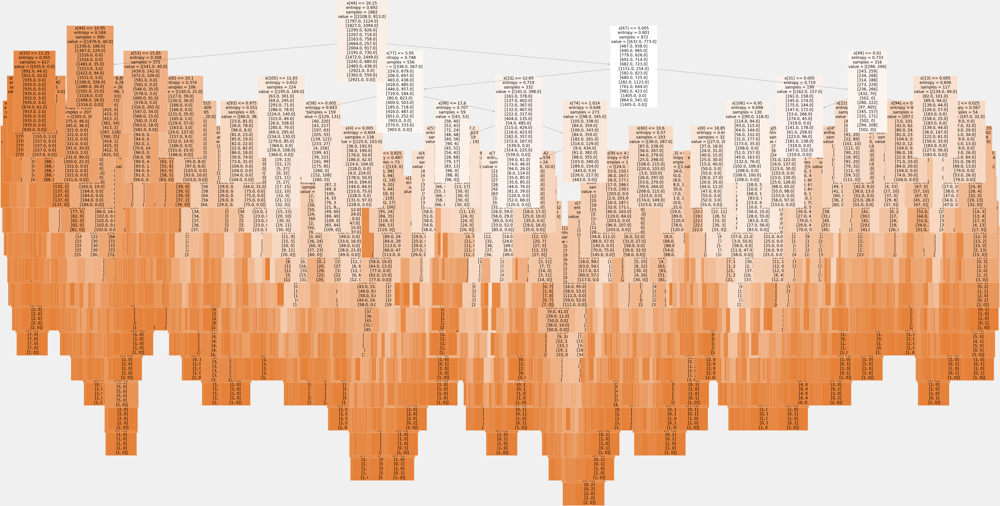

In [83]:
class_names = ['unpleasant', 'pleasant']
fig13 = plt.figure(figsize=(80,40))
plot_tree(clf4.estimators_[5], fontsize=20, class_names=class_names, filled=True)

In [84]:
fig13.savefig(f"{path}/04 Analysis/Visualizations/decision_tree13.png")

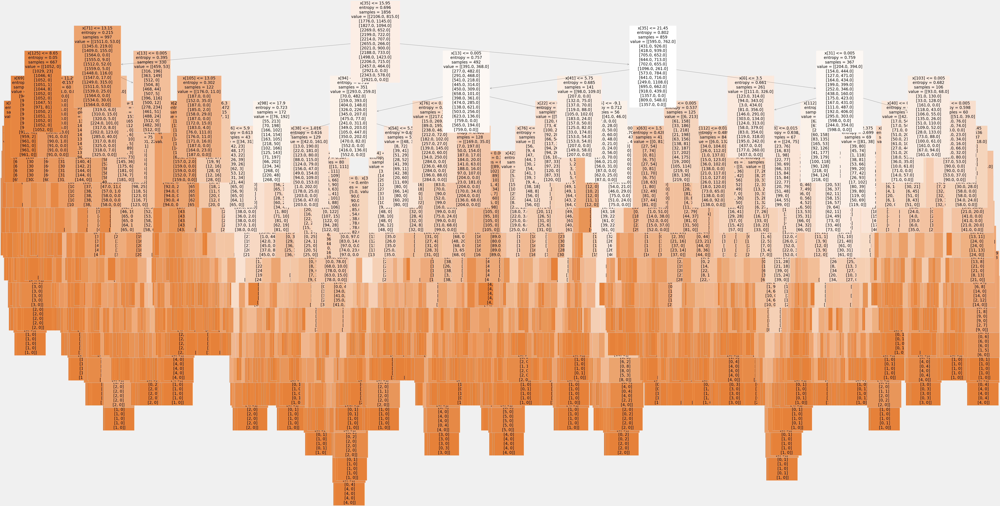

In [85]:
fig14 = plt.figure(figsize=(80,40))
plot_tree(clf4.estimators_[99], fontsize = 20, class_names=class_names, filled=True);

In [86]:
fig14.savefig(f"{path}/04 Analysis/Visualizations/decision_tree14.png")

In [87]:
np.set_printoptions(threshold=np.inf)
newarray = clf4.feature_importances_
#print(clf.feature_importances_.shape)
newarray

array([3.06061350e-03, 3.43094497e-03, 3.32694295e-03, 3.53993157e-03,
       1.88105223e-02, 7.37386369e-03, 2.57785348e-02, 3.95323664e-03,
       3.51477461e-02, 3.52399945e-03, 3.36390716e-03, 3.60402586e-03,
       2.87228148e-03, 1.77331601e-02, 3.17495435e-03, 9.41647240e-03,
       3.79524294e-03, 1.13564269e-02, 2.92750151e-04, 0.00000000e+00,
       0.00000000e+00, 1.30321126e-03, 1.50985436e-02, 1.38777315e-03,
       1.55443509e-02, 5.79136355e-03, 2.07938329e-02, 2.13275893e-03,
       2.74208594e-03, 4.33701221e-03, 4.09315882e-03, 1.59314836e-02,
       4.08441503e-03, 1.01156570e-02, 2.87841292e-03, 3.66857408e-02,
       2.48419074e-03, 2.95209617e-03, 4.04136232e-03, 3.78991385e-03,
       1.97245723e-02, 5.94187681e-03, 2.51330903e-02, 2.83108395e-03,
       4.48012350e-02, 2.56106029e-03, 3.96218074e-03, 3.67617367e-03,
       4.21823151e-03, 1.03528988e-02, 4.08681819e-03, 7.03053164e-03,
       3.45877809e-03, 1.54345456e-02, 3.16468410e-03, 2.25820897e-03,
      

In [88]:
np.set_printoptions(threshold=1000)

In [89]:
newarray = newarray.reshape(-1,15,9)
print(newarray.shape)
newarray

(1, 15, 9)


array([[[3.06061350e-03, 3.43094497e-03, 3.32694295e-03, 3.53993157e-03,
         1.88105223e-02, 7.37386369e-03, 2.57785348e-02, 3.95323664e-03,
         3.51477461e-02],
        [3.52399945e-03, 3.36390716e-03, 3.60402586e-03, 2.87228148e-03,
         1.77331601e-02, 3.17495435e-03, 9.41647240e-03, 3.79524294e-03,
         1.13564269e-02],
        [2.92750151e-04, 0.00000000e+00, 0.00000000e+00, 1.30321126e-03,
         1.50985436e-02, 1.38777315e-03, 1.55443509e-02, 5.79136355e-03,
         2.07938329e-02],
        [2.13275893e-03, 2.74208594e-03, 4.33701221e-03, 4.09315882e-03,
         1.59314836e-02, 4.08441503e-03, 1.01156570e-02, 2.87841292e-03,
         3.66857408e-02],
        [2.48419074e-03, 2.95209617e-03, 4.04136232e-03, 3.78991385e-03,
         1.97245723e-02, 5.94187681e-03, 2.51330903e-02, 2.83108395e-03,
         4.48012350e-02],
        [2.56106029e-03, 3.96218074e-03, 3.67617367e-03, 4.21823151e-03,
         1.03528988e-02, 4.08681819e-03, 7.03053164e-03, 3.45877809

In [90]:
sumarray3 = np.sum(newarray[0], axis=1)
sumarray3

array([0.10442234, 0.05884047, 0.06021183, 0.08300073, 0.11169942,
       0.05478122, 0.03021628, 0.0842687 , 0.11014834, 0.06544112,
       0.08584064, 0.05613262, 0.03136653, 0.05958812, 0.00404165])

In [91]:
important3 = pd.Series(sumarray3, index = stations).sort_values(ascending = False)
important3

DUSSELDORF    0.111699
MAASTRICHT    0.110148
BASEL         0.104422
MUNCHENB      0.085841
LJUBLJANA     0.084269
DEBILT        0.083001
MADRID        0.065441
BUDAPEST      0.060212
STOCKHOLM     0.059588
BELGRADE      0.058840
OSLO          0.056133
HEATHROW      0.054781
SONNBLICK     0.031367
KASSEL        0.030216
VALENTIA      0.004042
dtype: float64

Index(['BASEL_cloud_cover', 'BASEL_humidity', 'BASEL_pressure',
       'BASEL_global_radiation', 'BASEL_precipitation', 'BASEL_sunshine',
       'BASEL_temp_mean', 'BASEL_temp_min', 'BASEL_temp_max',
       'BELGRADE_cloud_cover',
       ...
       'STOCKHOLM_temp_max', 'VALENTIA_cloud_cover', 'VALENTIA_humidity',
       'VALENTIA_pressure', 'VALENTIA_global_radiation',
       'VALENTIA_precipitation', 'VALENTIA_sunshine', 'VALENTIA_temp_mean',
       'VALENTIA_temp_min', 'VALENTIA_temp_max'],
      dtype='object', length=135)


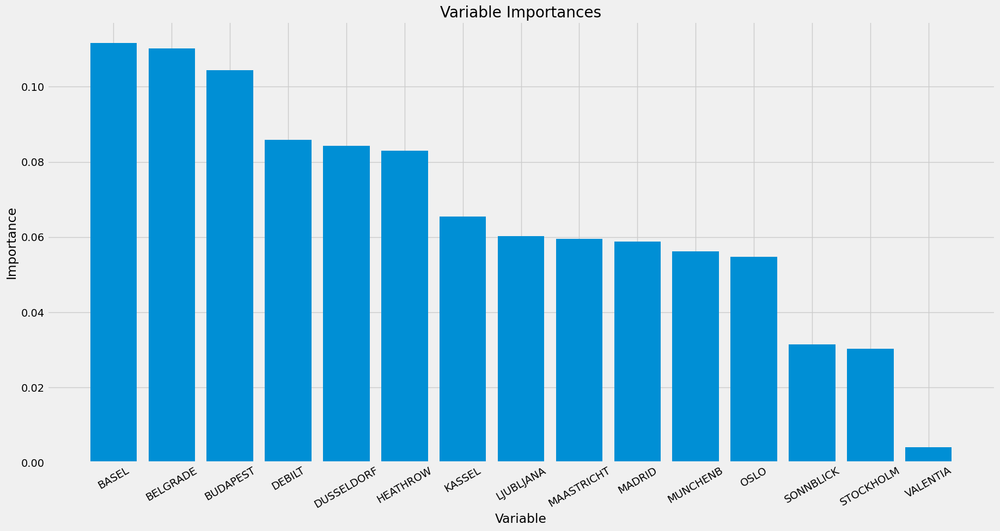

In [92]:
%matplotlib inline
plt.figure(figsize=(20,10))
plt.style.use('fivethirtyeight')
# list of x locations for plotting
x_values = list(range(len(important3)))
print(X.columns)

plt.bar(x_values, important3, orientation = 'vertical')
plt.xticks(x_values, stations, rotation=30)
plt.ylabel('Importance'); plt.xlabel('Variable'); plt.title('Variable Importances');

In [93]:
# By weather observations
sumarray4 = np.sum(newarray[0], axis=0)
sumarray4

array([0.03557487, 0.04401402, 0.04545119, 0.05762351, 0.19455513,
       0.06036354, 0.20012168, 0.05599962, 0.30629643])

In [94]:
important4 = pd.Series(sumarray4, index = unique_column_names).sort_values(ascending = False)
important4

precipitation       0.306296
global_radiation    0.200122
humidity            0.194555
temp_min            0.060364
temp_mean           0.057624
pressure            0.056000
sunshine            0.045451
temp_max            0.044014
cloud_cover         0.035575
dtype: float64

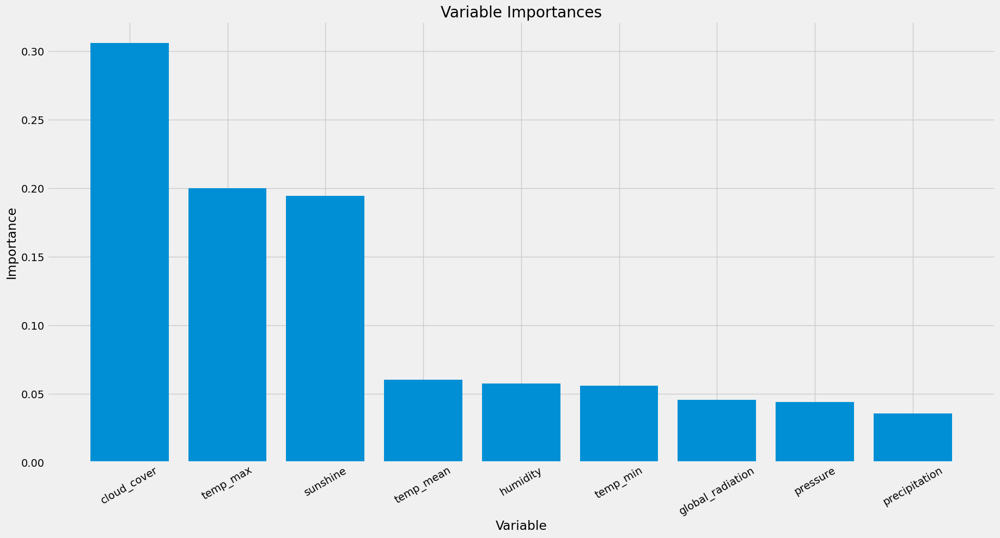

In [95]:
%matplotlib inline
plt.figure(figsize=(20, 10))
plt.style.use('fivethirtyeight')

# Plotting the importances
plt.bar(list(unique_column_names), list(important4), orientation='vertical')

# Rotating x-axis labels for better readability
plt.xticks(rotation=30)

# Adding labels and title
plt.ylabel('Importance')
plt.xlabel('Variable')
plt.title('Variable Importances')

plt.show()

## Filter DataFrame to include only data from the Basel Weather Station

In [96]:
# Filter DataFrame to include only data from the Basel Weather Station

# List of columns for BASEL weather station
basel_columns = ['BASEL_cloud_cover', 'BASEL_humidity', 'BASEL_pressure', 'BASEL_global_radiation', 
                'BASEL_precipitation', 'BASEL_sunshine', 'BASEL_temp_mean', 'BASEL_temp_min', 
                'BASEL_temp_max']

# Filter the dataframe to include only BASEL columns
basel_df = climate2[basel_columns]

In [97]:
basel_df.head()

,BASEL_cloud_cover,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_sunshine,BASEL_temp_mean,BASEL_temp_min,BASEL_temp_max
0,7,0.85,1.018,0.32,0.09,0.7,6.5,0.8,10.9
1,6,0.84,1.018,0.36,1.05,1.1,6.1,3.3,10.1
2,8,0.90,1.018,0.18,0.30,0.0,8.5,5.1,9.9
3,3,0.92,1.018,0.58,0.00,4.1,6.3,3.8,10.6
4,6,0.95,1.018,0.65,0.14,5.4,3.0,-0.7,6.0


In [98]:
basel_df.shape

(22950, 9)

In [99]:
# Filter Answers DataFrame to include only data from the Basel Weather Station
basel_pleasant_weather = answers2['BASEL_pleasant_weather']

In [100]:
basel_pleasant_weather.head()

0    0
1    0
2    0
3    0
4    0
Name: BASEL_pleasant_weather, dtype: int64

In [101]:
basel_pleasant_weather.shape

(22950,)

In [102]:
#Create an 'X' matrix
X = basel_df
y = basel_pleasant_weather

In [103]:
print(X.shape)
print(y.shape)

(22950, 9)
(22950,)


In [104]:
#Split data into training and testing sets.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [105]:
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(18360, 9) (18360,)
(4590, 9) (4590,)


In [106]:
y_train = y_train.astype(int)

In [107]:
y_train

12262    0
9334     1
7100     0
12030    0
2958     0
        ..
11964    0
21575    0
5390     0
860      0
15795    0
Name: BASEL_pleasant_weather, Length: 18360, dtype: int32

In [108]:
print(y_train.shape)
print(y_train)

(18360,)
12262    0
9334     1
7100     0
12030    0
2958     0
        ..
11964    0
21575    0
5390     0
860      0
15795    0
Name: BASEL_pleasant_weather, Length: 18360, dtype: int32


In [109]:
len(X_train)

18360

In [110]:
# creating a RF classifier
clf5 = RandomForestClassifier(n_estimators = 710, max_depth=60, max_features=13, min_samples_leaf=1, min_samples_split=2, criterion = 'entropy')  
  
# Training the model on the training dataset
# fit function is used to train the model using the training sets as parameters
clf5.fit(X_train, y_train)

RandomForestClassifier(criterion='entropy', max_depth=60, max_features=13,
                       n_estimators=710)

In [111]:
# performing predictions on the test dataset
y_pred = clf5.predict(X_test)
  
# using metrics module for accuracy calculation
print("Model Accuracy: ", metrics.accuracy_score(y_test, y_pred))

Model Accuracy:  1.0


[Text(0.4, 0.875, 'x[8] <= 17.95\nentropy = 0.814\nsamples = 11552\nvalue = [13743, 4617]\nclass = unpleasant'),
 Text(0.2, 0.625, 'entropy = 0.0\nsamples = 6814\nvalue = [10725, 0]\nclass = unpleasant'),
 Text(0.6, 0.625, 'x[4] <= 0.005\nentropy = 0.968\nsamples = 4738\nvalue = [3018, 4617]\nclass = pleasant'),
 Text(0.4, 0.375, 'x[5] <= 0.95\nentropy = 0.154\nsamples = 2920\nvalue = [105, 4617]\nclass = pleasant'),
 Text(0.2, 0.125, 'entropy = 0.0\nsamples = 63\nvalue = [105, 0]\nclass = unpleasant'),
 Text(0.6, 0.125, 'entropy = 0.0\nsamples = 2857\nvalue = [0, 4617]\nclass = pleasant'),
 Text(0.8, 0.375, 'entropy = 0.0\nsamples = 1818\nvalue = [2913, 0]\nclass = unpleasant')]

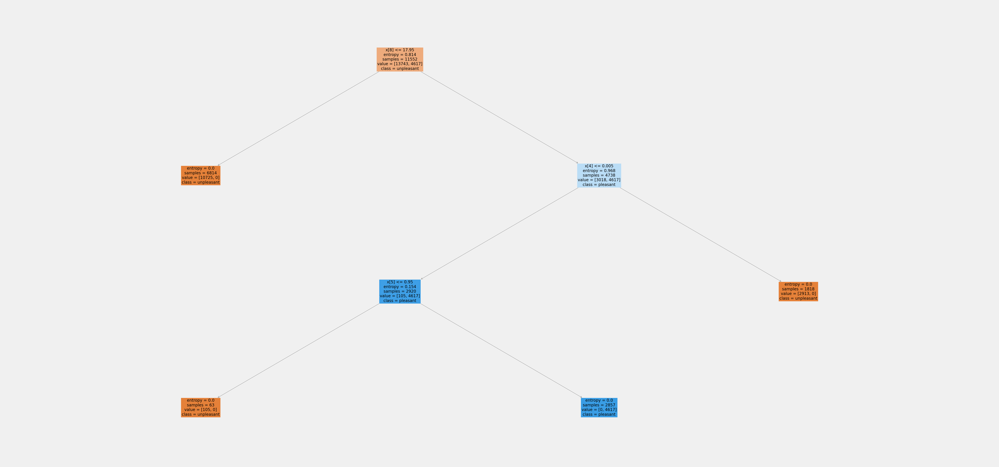

In [112]:
class_names = ['unpleasant', 'pleasant']
fig15 = plt.figure(figsize=(80,40))
plot_tree(clf5.estimators_[5], fontsize=20, class_names=class_names, filled=True)

In [113]:
fig15.savefig(f"{path}/04 Analysis/Visualizations/decision_tree15.png")

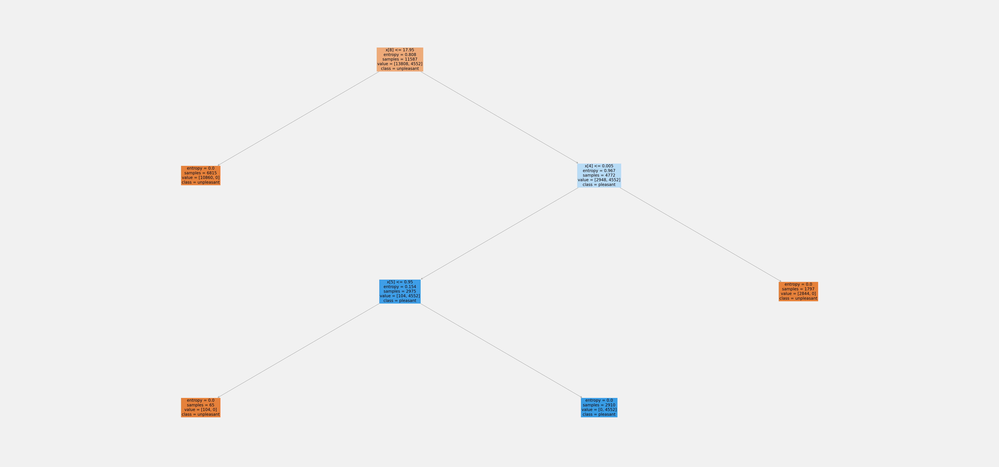

In [114]:
fig16 = plt.figure(figsize=(80,40))
plot_tree(clf5.estimators_[99], fontsize = 20, class_names=class_names, filled=True);

In [115]:
fig16.savefig(f"{path}/04 Analysis/Visualizations/decision_tree16.png")

In [116]:
np.set_printoptions(threshold=np.inf)
newarray = clf5.feature_importances_
#print(clf.feature_importances_.shape)
newarray

array([0.        , 0.        , 0.        , 0.        , 0.44340435,
       0.04435185, 0.        , 0.        , 0.5122438 ])

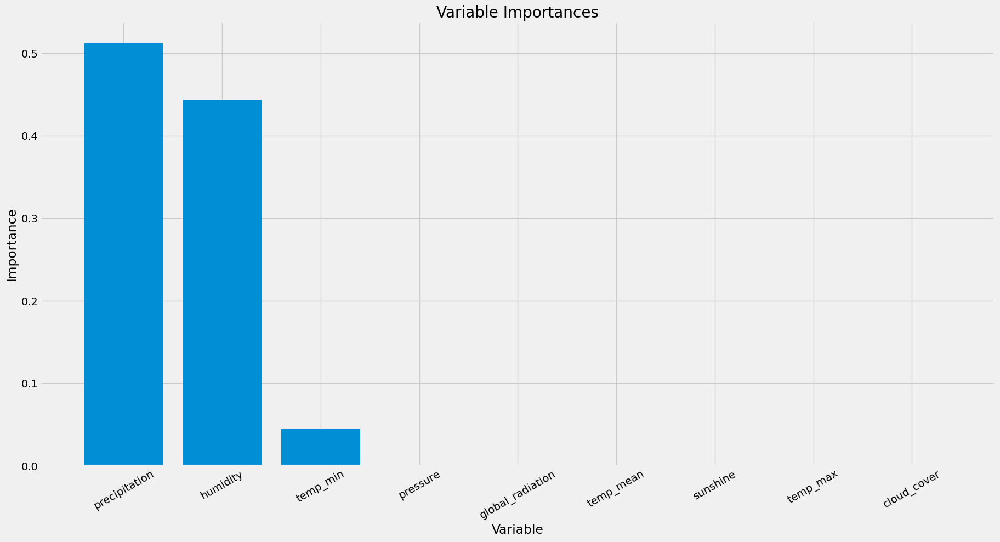

In [117]:
# Set the threshold for printing NumPy arrays to infinity
np.set_printoptions(threshold=np.inf)

# Convert unique_column_names to a list
unique_column_names = list(unique_column_names)

# Sort the feature importances and the column names together
sorted_indices = np.argsort(clf5.feature_importances_)[::-1]
sorted_column_names = [unique_column_names[i] for i in sorted_indices]
sorted_importances = clf5.feature_importances_[sorted_indices]

# Plotting the importances
plt.figure(figsize=(20, 10))
plt.style.use('fivethirtyeight')

# Plotting the bar chart
plt.bar(sorted_column_names, sorted_importances, orientation='vertical')

# Rotating x-axis labels for better readability
plt.xticks(rotation=30)

# Adding labels and title
plt.ylabel('Importance')
plt.xlabel('Variable')
plt.title('Variable Importances')

plt.show()

## Filter DataFrame to include only data from the Belgrade Weather Station

In [118]:
# Filter DataFrame to include only data from the Belgrade Weather Station

# List of columns for Belgrade weather station
belgrade_columns = ['BELGRADE_cloud_cover', 'BELGRADE_humidity', 'BELGRADE_pressure', 'BELGRADE_global_radiation', 
                    'BELGRADE_precipitation', 'BELGRADE_sunshine', 'BELGRADE_temp_mean', 'BELGRADE_temp_min', 
                    'BELGRADE_temp_max']

# Filter the dataframe to include only Belgrade columns
belgrade_df = climate2[belgrade_columns]

In [119]:
belgrade_df.head()

,BELGRADE_cloud_cover,BELGRADE_humidity,BELGRADE_pressure,BELGRADE_global_radiation,BELGRADE_precipitation,BELGRADE_sunshine,BELGRADE_temp_mean,BELGRADE_temp_min,BELGRADE_temp_max
0,1,0.81,1.0195,0.88,0.00,7.0,3.7,-0.9,7.9
1,6,0.84,1.0172,0.25,0.00,0.0,2.9,2.2,4.4
2,6,0.77,1.0179,0.67,0.00,3.5,3.1,-0.5,6.4
3,8,0.93,1.0268,0.25,0.00,0.0,2.0,-2.0,3.0
4,8,0.99,1.0286,0.25,0.06,0.0,2.0,0.7,2.8


In [120]:
belgrade_df.shape

(22950, 9)

In [121]:
# Filter Answers DataFrame to include only data from the Belgrade Weather Station
belgrade_pleasant_weather = answers2['BELGRADE_pleasant_weather']

In [122]:
belgrade_pleasant_weather.head()

0    0
1    0
2    0
3    0
4    0
Name: BELGRADE_pleasant_weather, dtype: int64

In [123]:
belgrade_pleasant_weather.shape

(22950,)

In [124]:
#Create an 'X' matrix
X = belgrade_df
y = belgrade_pleasant_weather

In [125]:
print(X.shape)
print(y.shape)

(22950, 9)
(22950,)


In [126]:
#Split data into training and testing sets.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [127]:
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(18360, 9) (18360,)
(4590, 9) (4590,)


In [128]:
y_train = y_train.astype(int)

In [129]:
y_train

12262    1
9334     1
7100     0
12030    0
2958     0
        ..
11964    1
21575    0
5390     1
860      0
15795    1
Name: BELGRADE_pleasant_weather, Length: 18360, dtype: int32

In [130]:
print(y_train.shape)
print(y_train)

(18360,)
12262    1
9334     1
7100     0
12030    0
2958     0
        ..
11964    1
21575    0
5390     1
860      0
15795    1
Name: BELGRADE_pleasant_weather, Length: 18360, dtype: int32


In [131]:
len(X_train)

18360

In [132]:
# creating a RF classifier
clf6 = RandomForestClassifier(n_estimators = 710, max_depth=60, max_features=13, min_samples_leaf=1, min_samples_split=2, criterion = 'entropy')  
  
# Training the model on the training dataset
# fit function is used to train the model using the training sets as parameters
clf6.fit(X_train, y_train)

RandomForestClassifier(criterion='entropy', max_depth=60, max_features=13,
                       n_estimators=710)

In [133]:
# performing predictions on the test dataset
y_pred = clf6.predict(X_test)
  
# using metrics module for accuracy calculation
print("Model Accuracy: ", metrics.accuracy_score(y_test, y_pred))

Model Accuracy:  1.0


[Text(0.4, 0.875, 'x[8] <= 17.95\nentropy = 0.927\nsamples = 11643\nvalue = [12071, 6289]\nclass = unpleasant'),
 Text(0.2, 0.625, 'entropy = 0.0\nsamples = 5629\nvalue = [8947, 0]\nclass = unpleasant'),
 Text(0.6, 0.625, 'x[4] <= 0.005\nentropy = 0.917\nsamples = 6014\nvalue = [3124, 6289]\nclass = pleasant'),
 Text(0.4, 0.375, 'x[5] <= 0.95\nentropy = 0.148\nsamples = 4124\nvalue = [136, 6289]\nclass = pleasant'),
 Text(0.2, 0.125, 'entropy = 0.0\nsamples = 83\nvalue = [136, 0]\nclass = unpleasant'),
 Text(0.6, 0.125, 'entropy = 0.0\nsamples = 4041\nvalue = [0, 6289]\nclass = pleasant'),
 Text(0.8, 0.375, 'entropy = 0.0\nsamples = 1890\nvalue = [2988, 0]\nclass = unpleasant')]

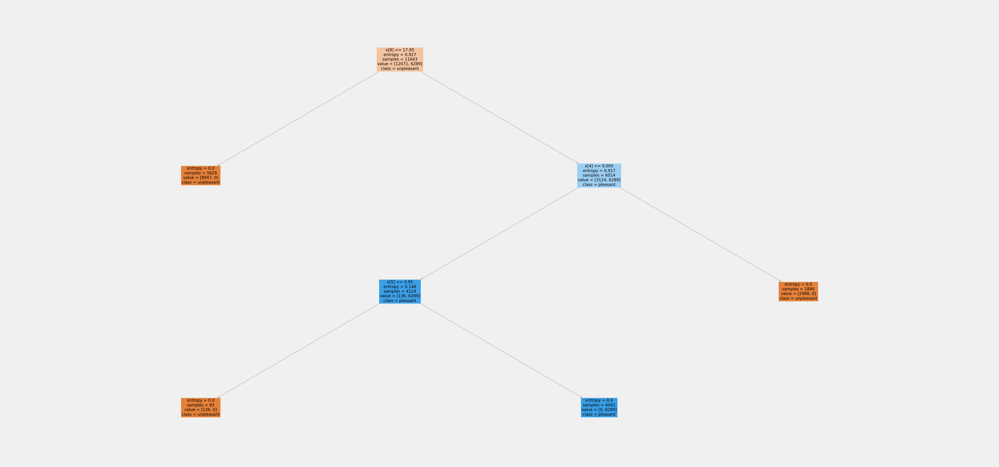

In [134]:
class_names = ['unpleasant', 'pleasant']
fig17 = plt.figure(figsize=(80,40))
plot_tree(clf6.estimators_[5], fontsize=20, class_names=class_names, filled=True)

In [135]:
fig17.savefig(f"{path}/04 Analysis/Visualizations/decision_tree17.png")

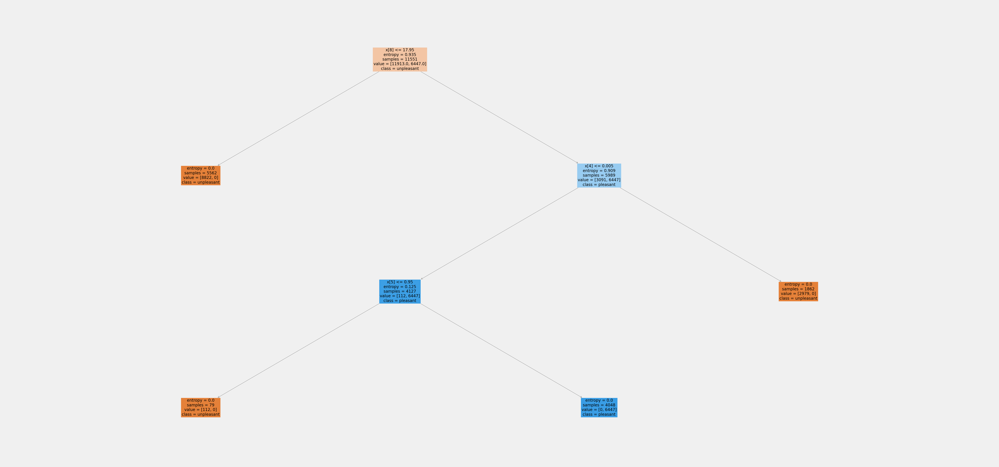

In [136]:
fig18 = plt.figure(figsize=(80,40))
plot_tree(clf6.estimators_[99], fontsize = 20, class_names=class_names, filled=True);

In [137]:
fig18.savefig(f"{path}/04 Analysis/Visualizations/decision_tree18.png")

In [138]:
np.set_printoptions(threshold=np.inf)
newarray = clf6.feature_importances_
#print(clf.feature_importances_.shape)
newarray

array([0.        , 0.        , 0.        , 0.        , 0.45012021,
       0.05303109, 0.        , 0.        , 0.4968487 ])

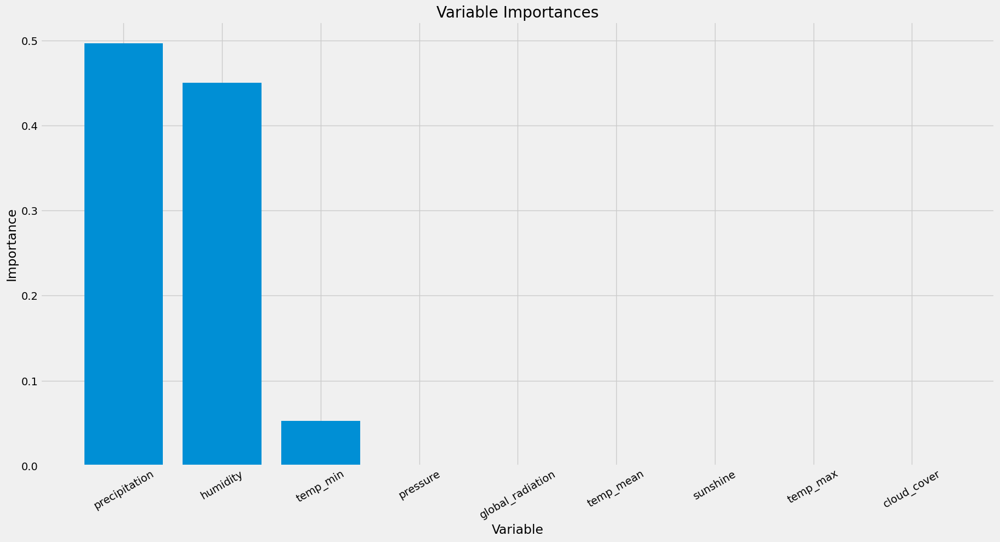

In [139]:
# Set the threshold for printing NumPy arrays to infinity
np.set_printoptions(threshold=np.inf)

# Convert unique_column_names to a list
unique_column_names = list(unique_column_names)

# Sort the feature importances and the column names together
sorted_indices = np.argsort(clf6.feature_importances_)[::-1]
sorted_column_names = [unique_column_names[i] for i in sorted_indices]
sorted_importances = clf6.feature_importances_[sorted_indices]

# Plotting the importances
plt.figure(figsize=(20, 10))
plt.style.use('fivethirtyeight')

# Plotting the bar chart
plt.bar(sorted_column_names, sorted_importances, orientation='vertical')

# Rotating x-axis labels for better readability
plt.xticks(rotation=30)

# Adding labels and title
plt.ylabel('Importance')
plt.xlabel('Variable')
plt.title('Variable Importances')

plt.show()

## Filter DataFrame to include only data from the Budapest Weather Station

In [140]:
# Filter DataFrame to include only data from the Budapest Weather Station

# List of columns for Budapest weather station
budapest_columns = ['BUDAPEST_cloud_cover', 'BUDAPEST_humidity', 'BUDAPEST_pressure', 'BUDAPEST_global_radiation', 
                    'BUDAPEST_precipitation', 'BUDAPEST_sunshine', 'BUDAPEST_temp_mean', 'BUDAPEST_temp_min', 
                    'BUDAPEST_temp_max']

# Filter the dataframe to include only Budapest columns
budapest_df = climate2[budapest_columns]

In [141]:
budapest_df.head()

,BUDAPEST_cloud_cover,BUDAPEST_humidity,BUDAPEST_pressure,BUDAPEST_global_radiation,BUDAPEST_precipitation,BUDAPEST_sunshine,BUDAPEST_temp_mean,BUDAPEST_temp_min,BUDAPEST_temp_max
0,4,0.67,1.017,0.44,0.01,2.3,2.4,-0.4,5.1
1,4,0.67,1.017,0.18,0.31,0.0,2.3,1.4,3.1
2,4,0.67,1.017,0.30,0.00,0.6,2.7,1.7,5.3
3,4,0.67,1.017,0.19,0.00,0.0,2.0,0.4,4.4
4,4,0.67,1.017,0.19,0.00,0.0,2.5,1.1,5.3


In [142]:
budapest_df.shape

(22950, 9)

In [143]:
# Filter Answers DataFrame to include only data from the Budapest Weather Station
budapest_pleasant_weather = answers2['BUDAPEST_pleasant_weather']

In [144]:
budapest_pleasant_weather.head()

0    0
1    0
2    0
3    0
4    0
Name: BUDAPEST_pleasant_weather, dtype: int64

In [145]:
budapest_pleasant_weather.shape

(22950,)

In [146]:
#Create an 'X' matrix
X = budapest_df
y = budapest_pleasant_weather

In [147]:
print(X.shape)
print(y.shape)

(22950, 9)
(22950,)


In [148]:
#Split data into training and testing sets.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [149]:
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(18360, 9) (18360,)
(4590, 9) (4590,)


In [150]:
y_train = y_train.astype(int)

In [151]:
y_train

12262    1
9334     1
7100     1
12030    0
2958     0
        ..
11964    1
21575    0
5390     0
860      0
15795    0
Name: BUDAPEST_pleasant_weather, Length: 18360, dtype: int32

In [152]:
print(y_train.shape)
print(y_train)

(18360,)
12262    1
9334     1
7100     1
12030    0
2958     0
        ..
11964    1
21575    0
5390     0
860      0
15795    0
Name: BUDAPEST_pleasant_weather, Length: 18360, dtype: int32


In [153]:
len(X_train)

18360

In [154]:
# creating a RF classifier
clf7 = RandomForestClassifier(n_estimators = 710, max_depth=60, max_features=13, min_samples_leaf=1, min_samples_split=2, criterion = 'entropy')  
  
# Training the model on the training dataset
# fit function is used to train the model using the training sets as parameters
clf7.fit(X_train, y_train)

RandomForestClassifier(criterion='entropy', max_depth=60, max_features=13,
                       n_estimators=710)

In [155]:
# performing predictions on the test dataset
y_pred = clf7.predict(X_test)
  
# using metrics module for accuracy calculation
print("Model Accuracy: ", metrics.accuracy_score(y_test, y_pred))

Model Accuracy:  1.0


[Text(0.4, 0.875, 'x[8] <= 17.95\nentropy = 0.912\nsamples = 11551\nvalue = [12353, 6007]\nclass = unpleasant'),
 Text(0.2, 0.625, 'entropy = 0.0\nsamples = 6234\nvalue = [9884, 0]\nclass = unpleasant'),
 Text(0.6, 0.625, 'x[4] <= 0.005\nentropy = 0.87\nsamples = 5317\nvalue = [2469, 6007]\nclass = pleasant'),
 Text(0.4, 0.375, 'x[5] <= 0.95\nentropy = 0.093\nsamples = 3803\nvalue = [72, 6007]\nclass = pleasant'),
 Text(0.2, 0.125, 'entropy = 0.0\nsamples = 46\nvalue = [72, 0]\nclass = unpleasant'),
 Text(0.6, 0.125, 'entropy = 0.0\nsamples = 3757\nvalue = [0, 6007]\nclass = pleasant'),
 Text(0.8, 0.375, 'entropy = 0.0\nsamples = 1514\nvalue = [2397, 0]\nclass = unpleasant')]

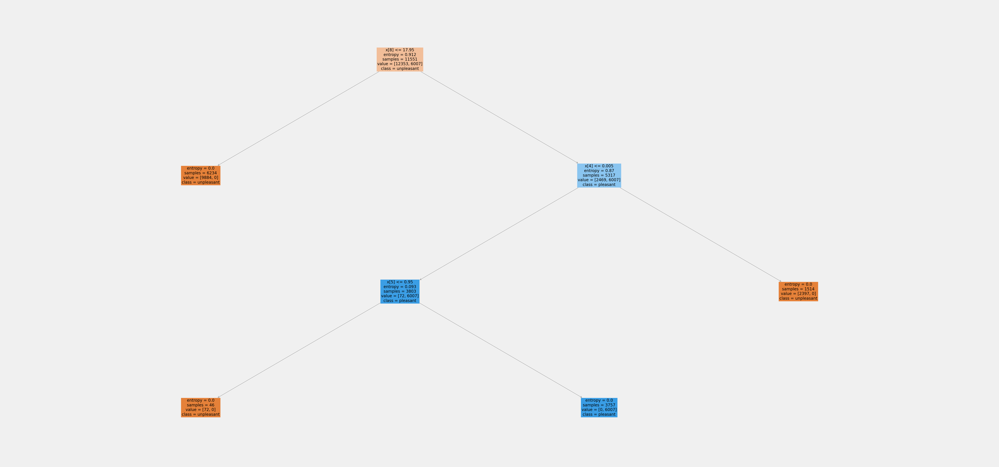

In [156]:
class_names = ['unpleasant', 'pleasant']
fig19 = plt.figure(figsize=(80,40))
plot_tree(clf7.estimators_[5], fontsize=20, class_names=class_names, filled=True)

In [157]:
fig19.savefig(f"{path}/04 Analysis/Visualizations/decision_tree19.png")

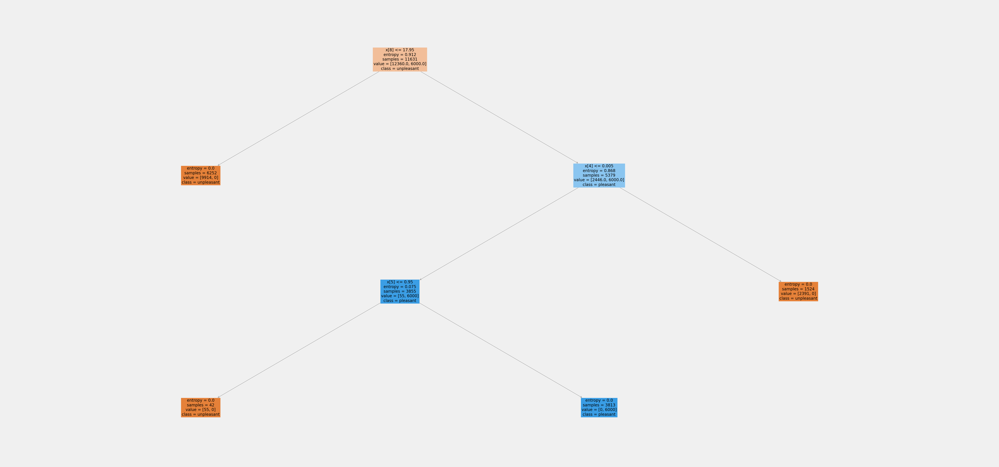

In [158]:
fig20 = plt.figure(figsize=(80,40))
plot_tree(clf7.estimators_[99], fontsize = 20, class_names=class_names, filled=True);

In [159]:
fig20.savefig(f"{path}/04 Analysis/Visualizations/decision_tree20.png")

In [160]:
np.set_printoptions(threshold=np.inf)
newarray = clf7.feature_importances_
#print(clf7.feature_importances_.shape)
newarray

array([0.        , 0.        , 0.        , 0.        , 0.41000542,
       0.03609782, 0.        , 0.        , 0.55389675])

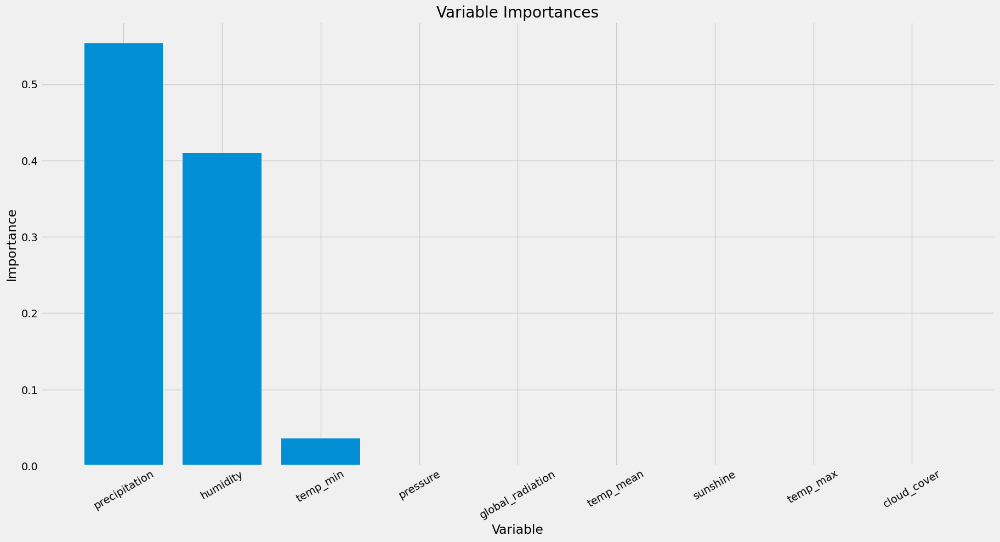

In [161]:
# Set the threshold for printing NumPy arrays to infinity
np.set_printoptions(threshold=np.inf)

# Convert unique_column_names to a list
unique_column_names = list(unique_column_names)

# Sort the feature importances and the column names together
sorted_indices = np.argsort(clf7.feature_importances_)[::-1]
sorted_column_names = [unique_column_names[i] for i in sorted_indices]
sorted_importances = clf7.feature_importances_[sorted_indices]

# Plotting the importances
plt.figure(figsize=(20, 10))
plt.style.use('fivethirtyeight')

# Plotting the bar chart
plt.bar(sorted_column_names, sorted_importances, orientation='vertical')

# Rotating x-axis labels for better readability
plt.xticks(rotation=30)

# Adding labels and title
plt.ylabel('Importance')
plt.xlabel('Variable')
plt.title('Variable Importances')

plt.show()